## Introduction

Develop a predictive model that can accurately forecast the traffic volume at a specified location in Auckland, for a specific date and time. Historical traffic data was leveraged along with relevant features such as date, time, day of the week, month, and weather conditions to build a model. Machine learning techniques were used to capture patterns, trends and seasonality in the traffic data, enabling it to make accurate predictions for future traffic volumes. The predicted traffic volume will aid in optimizing transportation planning, traffic management and resource allocation. The ultimate goal of enhancing efficiency, reducing congestion and improving overall traffic flow in a target area.

### Stakeholders

The key stakeholders that this project was targeted towards include Transportation agencies and urban developers. Transportation agencies can plan road maintenance, traffic signal timing and new infrastructure based on expected traffic demand. It will also aid in managing traffic flow and mitigating congestion. Urban developers can use this predictive modelling tool to give insights on how to design and develop transportation infrastructure (e.g. Road Networks, Highways, Bridges and Public transportation systems) to handle expected traffic volume. 

### Data

Predicting the traffic volume involves various external factors that may influence the number of cars seen for a given date and time. The most obvious being the traffic volume seen in a lagged interval (Hourly, Daily, Weekly etc.), the traffic count seen previously will give insight into what the traffic may be in the next interval. Other external factors that will affect traffic count are Holiday periods and weather. Holiday periods are expected to see less people on the roads as most people aren’t going to work. Weather may also affect the amount of people on the roads due to road conditions, safety concerns, events/festivals, and seasonal factors. The additional data would assist in the prediction of traffic. 

The data was sourced from NZ Transport Agency. Daily traffic volumes from various state highway count sites in 15-minute intervals, from 2013 to 2020. The data represents real world data.  https://opendata-nzta.opendata.arcgis.com/datasets/NZTA::tms-traffic-quarter-hourly-jan-2013-to-sept-2020/about
This project looks at the traffic count at Lincoln Rd SH16 East Bound Interchange (Auckland, New Zealand). The particular location is looking at traffic leaving the suburb and heading towards the city. This project also looks at the traffic count across 2017. It is important to note that since this is real-world data there are a lot of impurities that need to be considered. Sensors were used to collect the number of cars crossing the particular point, therefore the data is subject to technical or environmental factors. Also, due to the nature of recording, there may not be consistent recordings for every hour of everyday across the year, however, in general, the recordings taken were consistent throughout the year of 2017. 


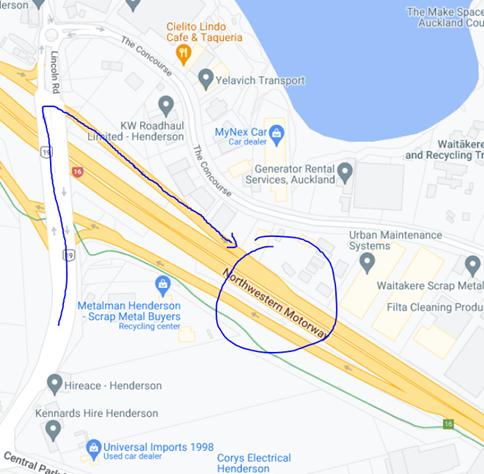

- Traffic flow has an impact in many things. Some of the problems we are trying to solve with this prediction are:
    - Traffic Management: Predicting traffic volume to help transportation authorities and city planners in manging traffic flow more effectively. Make more informed decisions on road closures, traffic signal timing, lane management etc
    - Infrastructure Planning: Urban planners can make data-driven decisions about construction etc
    - Demand Forecasting: Businesses can use this to manage customer demand etc. 
    - Route Optimization: For logistics and delivery companies

### This Notebook:

- This notebook looks at the Modelling side of predicting traffic count. Please check Traffic_Flow_EDA if you want to see the EDA process

- The features used to predict the target variable traffic count include traffic count 1-week prior, average temperature, average rainfall, and public holidays. Some of the features have more correlation than others with the target variable. Features were selected with correlation map and conclusions were drawn of these features through feature importance and forward feature selection. 
- Four models were used to predict traffic count. The problem at hand is a regression problem, the models chosen were – Linear Regression, Decision Tree, Random Forest and Prophet. The metrics used to evaluate these models included – Root Mean Squared Error (RMSE), Mean Absolute Error (MAE) and R2. These models were evaluated against each other based on the performance metrics and a final model was decided as the best performing. 

- The data was split into training set and testing set when modelling. The split was done in an 80/20 split, where the training set represented the first 10 months, and the model was evaluated on the last 2 months (of the 2017 data). 


In [1]:
import pandas as pd
import calendar
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import datetime

In [2]:
final_df = pd.read_csv('final_df.csv') #Read in your data for modelling here (Cleaned Data)
final_df

,DateTime,count,Week_Day,month,Public_Hol,avg_temp,avg_rainfall
0,2017-03-04 00:00:00,197.0,Saturday,3,False,19,3.333333
1,2017-03-04 01:00:00,111.0,Saturday,3,False,19,3.333333
2,2017-03-04 02:00:00,80.0,Saturday,3,False,19,3.333333
3,2017-03-04 03:00:00,85.0,Saturday,3,False,19,3.333333
4,2017-03-04 04:00:00,130.0,Saturday,3,False,19,3.333333
...,...,...,...,...,...,...,...
7002,2017-12-30 19:00:00,915.0,Saturday,12,False,18,2.142857
7003,2017-12-30 20:00:00,724.0,Saturday,12,False,18,2.142857
7004,2017-12-30 21:00:00,650.0,Saturday,12,False,18,2.142857
7005,2017-12-30 22:00:00,514.0,Saturday,12,False,18,2.142857


In [3]:
final_df.columns

Index(['DateTime', 'count', 'Week_Day', 'month', 'Public_Hol', 'avg_temp',
       'avg_rainfall'],
      dtype='object')

In [4]:
final_df.dtypes

DateTime         object
count           float64
Week_Day         object
month             int64
Public_Hol         bool
avg_temp          int64
avg_rainfall    float64
dtype: object

In [5]:
final_df['DateTime'] = pd.to_datetime(final_df['DateTime'])

In [6]:
final_df.set_index('DateTime', inplace=True)

# Model

In [7]:
from sktime.forecasting.base import ForecastingHorizon
from sktime.forecasting.model_selection import temporal_train_test_split
from sktime.forecasting.theta import ThetaForecaster
from sktime.performance_metrics.forecasting import mean_absolute_percentage_error
import pandas as pd
from sktime.utils.plotting import plot_series
import sys
from sklearn.metrics import mean_absolute_error, r2_score
from sktime.forecasting.arima import AutoARIMA
from sktime.forecasting.fbprophet import Prophet
import matplotlib.pyplot as plt
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error

from sktime.forecasting.base import ForecastingHorizon
from sktime.forecasting.theta import ThetaForecaster

from prophet import Prophet

c:\Users\I am Navin\AppData\Local\Programs\Python\Python39\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Regression:
- Using Machine Learning Models to Predict Traffic Count

## Linear Regression

In [8]:
reg_df = final_df.resample(rule="H").sum()

In [9]:
#Rename
reg_df = reg_df.rename(columns={'count': 'y'})
reg_df['ds'] = reg_df.index
reg_df.head()

,y,month,Public_Hol,avg_temp,avg_rainfall,ds
DateTime,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00


In [10]:
reg_df.dtypes

y                      float64
month                    int64
Public_Hol               int64
avg_temp                 int64
avg_rainfall           float64
ds              datetime64[ns]
dtype: object

In [11]:
#Time-Step Feature
reg_df['Time'] = np.arange(len(reg_df.index))
reg_df.head()

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time
DateTime,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4


### Fitting Linear Model

In [12]:
X = reg_df.loc[:, ['Time']]
y = reg_df.loc[:, 'y']

In [13]:
lr_mod = LinearRegression()
lr_mod.fit(X, y)

LinearRegression()

In [14]:
# Store the fitted values as a time series with the same time index as
# the training data
y_pred = pd.Series(lr_mod.predict(X), index=X.index)
y_pred

DateTime
2017-03-04 00:00:00    1052.007554
2017-03-04 01:00:00    1052.027116
2017-03-04 02:00:00    1052.046677
2017-03-04 03:00:00    1052.066238
2017-03-04 04:00:00    1052.085800
                          ...     
2017-12-30 19:00:00    1193.690139
2017-12-30 20:00:00    1193.709700
2017-12-30 21:00:00    1193.729261
2017-12-30 22:00:00    1193.748822
2017-12-30 23:00:00    1193.768384
Freq: H, Length: 7248, dtype: float64

In [15]:
plot_params = dict(
    color="0.75",
    style=".-",
    markeredgecolor="0.25",
    markerfacecolor="0.25",
    legend=False,
)

Text(0.5, 1.0, 'Time Plot of Traffic')

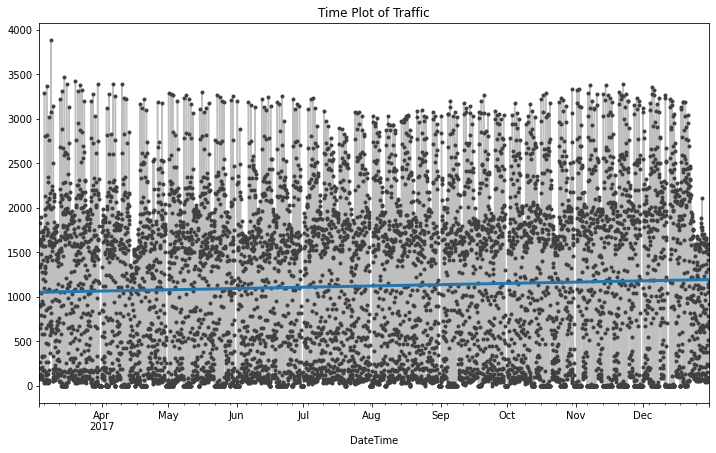

In [16]:
ax = plt.figure(figsize=(12,7))
ax = y.plot(**plot_params)
ax = y_pred.plot(ax=ax, linewidth=3)

ax.set_title('Time Plot of Traffic')



- Plotting the fitted values over time using time dummy variables

### Lag Feature (Lr)

In [17]:
#A function that creates the Lagged Column. This function is better than just shifting because for this particular dataset, is incosistent. And there may be times where the lagged before isnt the exact lag from that time point.  
def lag_creator(dataframe, lag_type): #lag_type = 'Lag_1','Lag_24', 'Lag_1wk'
    lag_df = pd.DataFrame(columns=['LaggedDateTime','currentDate'])
    dataframe.reset_index(inplace=True)
    for index, row in dataframe.iterrows():
        print(lag_type)
        # Current Date
        current_date = row['DateTime']
        
        if lag_type == 'Lag_1':
            # 1 hour Ago Date
            lagged_date = current_date - datetime.timedelta(hours=1)
        if lag_type == 'Lag_24':
            lagged_date = current_date - datetime.timedelta(hours=24)
        if lag_type == 'Lag_1wk':
            lagged_date = current_date - datetime.timedelta(weeks=1)
        else:
            print("Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'")
        
        # Check if there is a row with the week ago date
        lagged_data = dataframe[dataframe['DateTime'] == lagged_date]
        
        if not lagged_data.empty:
            print(f"{lag_type} AGO:")
            print(lagged_data)
            lagged_count = lagged_data['y'].values[0]
            print(lagged_count)

            lag_df = lag_df.append([{'LaggedDateTime':lagged_date,f'{lag_type}':lagged_count, 'currentDate':current_date}])
            print(lag_df)
        else:
            lag_df = lag_df.append([{'LaggedDateTime':lagged_date,f'{lag_type}': float("NaN"), 'currentDate':current_date}])
            print('No Lag data')
    
    dataframe = dataframe.merge(lag_df, left_on='DateTime', right_on='currentDate')
    dataframe = dataframe.drop(columns=['LaggedDateTime','currentDate'])
    dataframe = dataframe.rename(columns={'lag_count': f'Lag_1'})
    dataframe = dataframe.set_index('DateTime')


    return dataframe


In [18]:
reg_df = lag_creator(reg_df, 'Lag_1')

Lag_1
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_1
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
Lag_1 AGO:
    DateTime      y  month  Public_Hol  avg_temp  avg_rainfall         ds  \
0 2017-03-04  197.0      3           0        19      3.333333 2017-03-04   

   Time  
0     0  
197.0
       LaggedDateTime         currentDate  Lag_1
0 2017-03-03 23:00:00 2017-03-04 00:00:00    NaN
0 2017-03-04 00:00:00 2017-03-04 01:00:00  197.0
Lag_1
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
Lag_1 AGO:
             DateTime      y  month  Public_Hol  avg_temp  avg_rainfall  \
1 2017-03-04 01:00:00  111.0      3           0        19      3.333333   

                   ds  Time  
1 2017-03-04 01:00:00     1  
111.0
       LaggedDateTime         currentDate  Lag_1
0 2017-03-03 23:00:00 2017-03-04 00:00:00    NaN
0 2017-03-04 00:00:00 2017-03-04 01:00:00  197.0
0 2017-03-04 01:00:00 2017-03-04 02:00:00  111.0
Lag_1
Enter one of these optio

In [19]:
#Shifted traffic from 1 hour ago
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1
DateTime,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0
...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0


In [20]:
# reg_df['y'].shift(1) #Shift by the traffic from 1 hour ago? 1 day ago? 1 Week ago?

In [21]:
# reg_df['Lag_1'] = reg_df['y'].shift(1) #Shifting by 1 hour ago traffic
# reg_df.head()

In [22]:
reg_df.columns

Index(['y', 'month', 'Public_Hol', 'avg_temp', 'avg_rainfall', 'ds', 'Time',
       'Lag_1'],
      dtype='object')

In [23]:
X = reg_df.loc[:, ['Lag_1']]
X.dropna(inplace= True) #Drop missing values in the feature set
y = reg_df.loc[:,'y']
y, X = y.align(X, join ='inner') #Drop the equivalent rows in target


In [24]:
lr_mod = LinearRegression()
lr_mod.fit(X,y)

LinearRegression()

In [25]:
y_pred = pd.Series(lr_mod.predict(X), index = X.index)

Text(0.5, 1.0, '1 hour Lag Plot of Traffic')

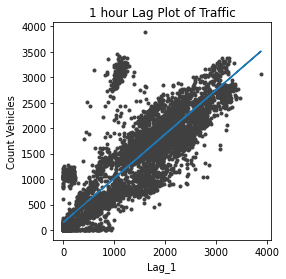

In [26]:
fig, ax = plt.subplots()
ax.plot(X['Lag_1'], y, '.', color='0.25')
ax.plot(X['Lag_1'], y_pred)
ax.set_aspect('equal')
ax.set_ylabel('Count Vehicles')
ax.set_xlabel('Lag_1')
ax.set_title('1 hour Lag Plot of Traffic')



- Lag Plot of Traffic shows how well the model fit the relationship between Vehicle Count in 1 hour vs the number the previous hour

#### Lag - 24 hours

In [27]:
reg_df = lag_creator(reg_df, 'Lag_24')

Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk'
No Lag data
Lag_24
Enter one of these options: 'Lag_1','Lag_24', or 'Lag_1wk

In [28]:
# reg_df['Lag_24'] = reg_df['y'].shift(1*24) #Shifting by 1 Day ago traffic
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24
DateTime,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN
...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0


In [29]:
X = reg_df.loc[:, ['Lag_24']]
X.dropna(inplace= True) #Drop missing values in the feature set
y = reg_df.loc[:,'y']
y, X = y.align(X, join ='inner') #Drop the equivalent rows in target


In [30]:
X

,Lag_24
DateTime,
2017-03-05 00:00:00,197.0
2017-03-05 01:00:00,111.0
2017-03-05 02:00:00,80.0
2017-03-05 03:00:00,85.0
2017-03-05 04:00:00,130.0
...,...
2017-12-30 19:00:00,860.0
2017-12-30 20:00:00,695.0
2017-12-30 21:00:00,672.0


In [31]:
y

DateTime
2017-03-05 00:00:00    211.0
2017-03-05 01:00:00    126.0
2017-03-05 02:00:00    103.0
2017-03-05 03:00:00     72.0
2017-03-05 04:00:00     97.0
                       ...  
2017-12-30 19:00:00    915.0
2017-12-30 20:00:00    724.0
2017-12-30 21:00:00    650.0
2017-12-30 22:00:00    514.0
2017-12-30 23:00:00    234.0
Name: y, Length: 7224, dtype: float64

In [32]:
lr_mod = LinearRegression()
lr_mod.fit(X,y)

LinearRegression()

In [33]:
y_pred = pd.Series(lr_mod.predict(X), index = X.index)

Text(0.5, 1.0, '24 hour Lag Plot of Traffic')

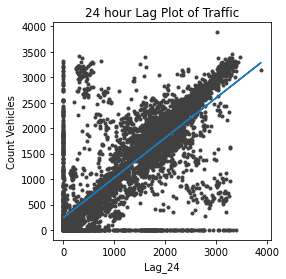

<Figure size 864x504 with 0 Axes>

In [34]:
fig, ax = plt.subplots()
plt.figure(figsize = (12,7))
ax.plot(X['Lag_24'], y, '.', color='0.25')
ax.plot(X['Lag_24'], y_pred)
ax.set_aspect('equal')
ax.set_ylabel('Count Vehicles')
ax.set_xlabel('Lag_24')
ax.set_title('24 hour Lag Plot of Traffic')



#### Lag - 1 Week

In [35]:
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24
DateTime,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN
...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0


In [36]:
reg_df = lag_creator(reg_df, 'Lag_1wk')

Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data


In [37]:
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0,1098.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0,957.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0,1018.0


In [38]:
# reg_df['Lag_1wk'] = reg_df['y'].shift(1*24*7) #Shifting by 1 Week ago traffic
reg_df.head()

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN


In [39]:
X = reg_df.loc[:, ['Lag_1wk']]
X.dropna(inplace= True) #Drop missing values in the feature set
y = reg_df.loc[:,'y']
y, X = y.align(X, join ='inner') #Drop the equivalent rows in target


In [40]:
X

,Lag_1wk
DateTime,
2017-03-11 00:00:00,197.0
2017-03-11 01:00:00,111.0
2017-03-11 02:00:00,80.0
2017-03-11 03:00:00,85.0
2017-03-11 04:00:00,130.0
...,...
2017-12-30 19:00:00,1098.0
2017-12-30 20:00:00,957.0
2017-12-30 21:00:00,1018.0


In [41]:
lr_mod = LinearRegression()
lr_mod.fit(X,y)

LinearRegression()

In [42]:
y_pred = pd.Series(lr_mod.predict(X), index = X.index)

Text(0.5, 1.0, '1 Week Lag Plot of Traffic')

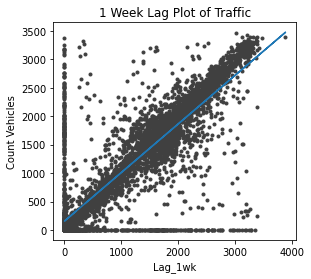

<Figure size 864x504 with 0 Axes>

In [43]:
fig, ax = plt.subplots()
plt.figure(figsize = (12,7))
ax.plot(X['Lag_1wk'], y, '.', color='0.25')
ax.plot(X['Lag_1wk'], y_pred)
ax.set_aspect('equal')
ax.set_ylabel('Count Vehicles')
ax.set_xlabel('Lag_1wk')
ax.set_title('1 Week Lag Plot of Traffic')



## Trend Model

In [44]:
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0,1098.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0,957.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0,1018.0


<AxesSubplot:title={'center':'Traffic - 30-Day Moving Average'}, xlabel='DateTime'>

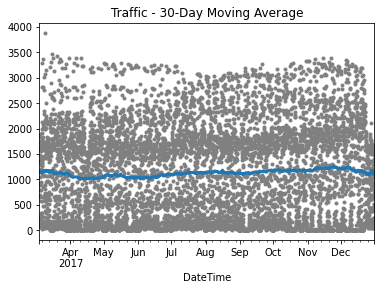

In [45]:
moving_average = reg_df['y'].rolling(
    window = 30*24,   # 30-day window
    center=True,      # puts the average at the center of the window
    min_periods= int((30*24) / 2)  # choose about half the window size
).mean()              # compute the mean (could also do median, std, min, max, ...)

ax = reg_df['y'].plot(style=".", color="0.5")
moving_average.plot(
    ax=ax, linewidth=3, title="Traffic - 30-Day Moving Average", legend=False,
)



- Trend is hard to conclude. 
    - Somehwat linear

### DeterministicProcess:
- a system in which no randomness is involved in the development of future states of the system. A deterministic model will thus always produce the same output from a given starting condition or initial state.

In [46]:
from statsmodels.tsa.deterministic import DeterministicProcess

In [47]:
dp = DeterministicProcess(
    index= reg_df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order=1,             # the time dummy (trend). 1: Linear, 2: Quadratic, 3: Cubic etc
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend
DateTime,,
2017-03-04 00:00:00,1.0,1.0
2017-03-04 01:00:00,1.0,2.0
2017-03-04 02:00:00,1.0,3.0
2017-03-04 03:00:00,1.0,4.0
2017-03-04 04:00:00,1.0,5.0


In [48]:
y = reg_df["y"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.

lr_mod = LinearRegression(fit_intercept=False)
lr_mod.fit(X, y)

y_pred = pd.Series(lr_mod.predict(X), index=X.index)

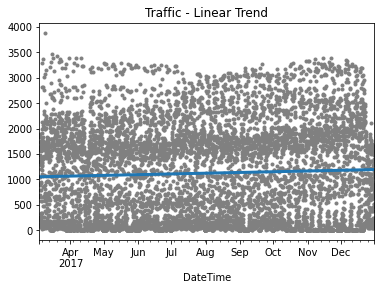

In [49]:
ax = reg_df['y'].plot(style=".", color="0.5", title="Traffic - Linear Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

In [50]:
dp = DeterministicProcess(
    index= reg_df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order= 2,             # the time dummy (trend). 1: Linear, 2: Quadratic, 3: Cubic etc
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend,trend_squared
DateTime,,,
2017-03-04 00:00:00,1.0,1.0,1.0
2017-03-04 01:00:00,1.0,2.0,4.0
2017-03-04 02:00:00,1.0,3.0,9.0
2017-03-04 03:00:00,1.0,4.0,16.0
2017-03-04 04:00:00,1.0,5.0,25.0


In [51]:
y = reg_df["y"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.

lr_mod = LinearRegression(fit_intercept=False)
lr_mod.fit(X, y)

y_pred = pd.Series(lr_mod.predict(X), index=X.index)

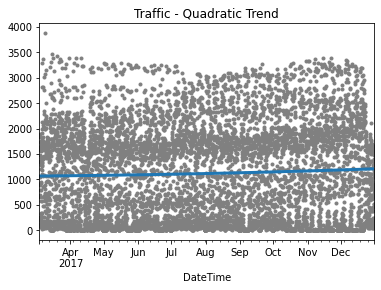

In [52]:
ax = reg_df['y'].plot(style=".", color="0.5", title="Traffic - Quadratic Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

In [53]:
dp = DeterministicProcess(
    index= reg_df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order= 3,             # the time dummy (trend). 1: Linear, 2: Quadratic, 3: Cubic etc
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend,trend_squared,trend_cubed
DateTime,,,,
2017-03-04 00:00:00,1.0,1.0,1.0,1.0
2017-03-04 01:00:00,1.0,2.0,4.0,8.0
2017-03-04 02:00:00,1.0,3.0,9.0,27.0
2017-03-04 03:00:00,1.0,4.0,16.0,64.0
2017-03-04 04:00:00,1.0,5.0,25.0,125.0


In [54]:
y = reg_df["y"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.

lr_mod = LinearRegression(fit_intercept=False)
lr_mod.fit(X, y)

y_pred = pd.Series(lr_mod.predict(X), index=X.index)

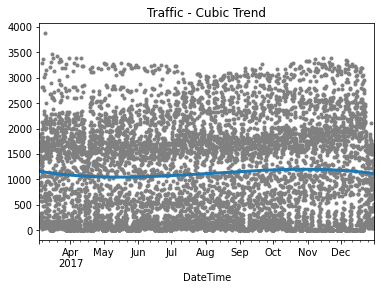

In [55]:
ax = reg_df['y'].plot(style=".", color="0.5", title="Traffic - Cubic Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

In [56]:
dp = DeterministicProcess(
    index= reg_df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order= 4,             # the time dummy (trend). 1: Linear, 2: Quadratic, 3: Cubic etc
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend,trend_squared,trend_cubed
DateTime,,,,
2017-03-04 00:00:00,1.0,1.0,1.0,1.0
2017-03-04 01:00:00,1.0,2.0,4.0,8.0
2017-03-04 02:00:00,1.0,3.0,9.0,27.0
2017-03-04 03:00:00,1.0,4.0,16.0,64.0
2017-03-04 04:00:00,1.0,5.0,25.0,125.0


In [57]:
y = reg_df["y"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.

lr_mod = LinearRegression(fit_intercept=False)
lr_mod.fit(X, y)

y_pred = pd.Series(lr_mod.predict(X), index=X.index)

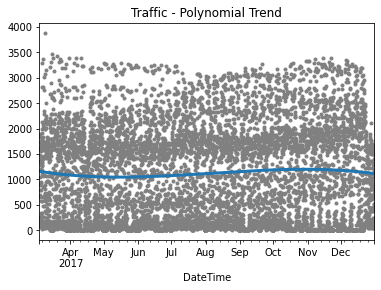

In [58]:
ax = reg_df['y'].plot(style=".", color="0.5", title="Traffic - Polynomial Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

In [59]:
#Forecast
X = dp.out_of_sample(steps=30*24) #30 Day forecast

y_fore = pd.Series(lr_mod.predict(X), index=X.index)

y_fore.head()

c:\Users\I am Navin\AppData\Local\Programs\Python\Python39\lib\site-packages\statsmodels\tsa\deterministic.py:302: UserWarning: Only PeriodIndexes, DatetimeIndexes with a frequency set, RangesIndexes, and Index with a unit increment support extending. The index is set will contain the position relative to the data length.
  fcast_index = self._extend_index(index, steps, forecast_index)


7249    1115.817044
7250    1115.695595
7251    1115.574044
7252    1115.452391
7253    1115.330635
dtype: float64

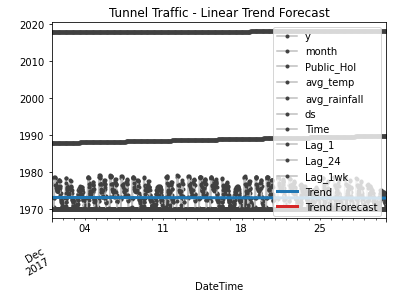

In [60]:
y_fore.index = pd.to_datetime(y_fore.index)
ax = reg_df["2017-12":].plot(title="Tunnel Traffic - Linear Trend Forecast", **plot_params)
ax = y_pred["2017-12":].plot(ax=ax, linewidth=3, label="Trend")
ax = y_fore.plot(ax=ax, linewidth=3, label="Trend Forecast", color="C3")
_ = ax.legend()

## Seasonality - Linear Regression

In [61]:
# annotations: https://stackoverflow.com/a/49238256/5769929
def seasonal_plot(X, y, period, freq, ax=None):
    if ax is None:
        _, ax = plt.subplots()
    palette = sns.color_palette("husl", n_colors=X[period].nunique(),)
    ax = sns.lineplot(
        x=freq,
        y=y,
        hue=period,
        data=X,
        ci=False,
        ax=ax,
        palette=palette,
        legend=False,
    )
    ax.set_title(f"Seasonal Plot ({period}/{freq})")
    for line, name in zip(ax.lines, X[period].unique()):
        y_ = line.get_ydata()[-1]
        ax.annotate(
            name,
            xy=(1, y_),
            xytext=(6, 0),
            color=line.get_color(),
            xycoords=ax.get_yaxis_transform(),
            textcoords="offset points",
            size=14,
            va="center",
        )
    return ax


def plot_periodogram(ts, detrend='linear', ax=None):
    from scipy.signal import periodogram
    fs = pd.Timedelta("1Y") / pd.Timedelta("1D")
    freqencies, spectrum = periodogram(
        ts,
        fs=fs,
        detrend=detrend,
        window="boxcar",
        scaling='spectrum',
    )
    if ax is None:
        _, ax = plt.subplots()
    ax.step(freqencies, spectrum, color="purple")
    ax.set_xscale("log")
    ax.set_xticks([1, 2, 4, 6, 12, 26, 52, 104])
    ax.set_xticklabels(
        [
            "Annual (1)",
            "Semiannual (2)",
            "Quarterly (4)",
            "Bimonthly (6)",
            "Monthly (12)",
            "Biweekly (26)",
            "Weekly (52)",
            "Semiweekly (104)",
        ],
        rotation=30,
    )
    ax.ticklabel_format(axis="y", style="sci", scilimits=(0, 0))
    ax.set_ylabel("Variance")
    ax.set_title("Periodogram")
    return ax


C:\Users\I am Navin\AppData\Local\Temp\ipykernel_13944\4115194540.py:4: FutureWarning: weekofyear and week have been deprecated, please use DatetimeIndex.isocalendar().week instead, which returns a Series.  To exactly reproduce the behavior of week and weekofyear and return an Index, you may call pd.Int64Index(idx.isocalendar().week)
  lr_szn["week"] = lr_szn.index.week  # the seasonal period (period)
C:\Users\I am Navin\AppData\Local\Temp\ipykernel_13944\1920661747.py:6: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', False)` for the same effect.

  ax = sns.lineplot(
C:\Users\I am Navin\AppData\Local\Temp\ipykernel_13944\1920661747.py:6: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=('ci', False)` for the same effect.

  ax = sns.lineplot(


<AxesSubplot:title={'center':'Seasonal Plot (year/dayofyear)'}, xlabel='dayofyear', ylabel='y'>

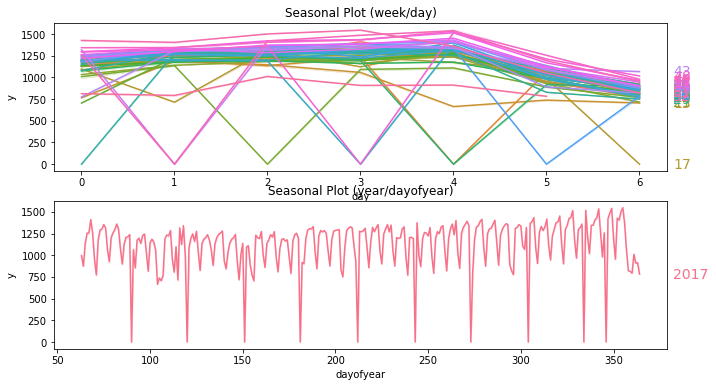

In [62]:
lr_szn = reg_df.copy()
# days within a week
lr_szn["day"] = lr_szn.index.dayofweek  # the x-axis (freq)
lr_szn["week"] = lr_szn.index.week  # the seasonal period (period)

# days within a year
lr_szn["dayofyear"] = lr_szn.index.dayofyear
lr_szn["year"] = lr_szn.index.year
fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(11, 6))
seasonal_plot(lr_szn, y="y", period="week", freq="day", ax=ax0)
seasonal_plot(lr_szn, y="y", period="year", freq="dayofyear", ax=ax1)

C:\Users\I am Navin\AppData\Local\Temp\ipykernel_13944\788840447.py:3: FutureWarning: Units 'M', 'Y' and 'y' do not represent unambiguous timedelta values and will be removed in a future version
  plot_periodogram(lr_szn.y)


<AxesSubplot:title={'center':'Periodogram'}, ylabel='Variance'>

<Figure size 864x504 with 0 Axes>

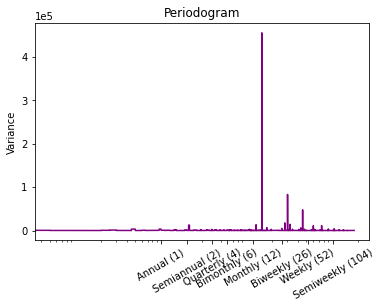

In [63]:
#Periodogram: Tells us how many Foruier Pairs we include in feature set. Tells the strength of frequencies in time series
plt.figure(figsize=(12,7))
plot_periodogram(lr_szn.y)


- A strong Monthly Season and week Annual Season
- How many Fourier Pairs to choose?

In [64]:
from statsmodels.tsa.deterministic import CalendarFourier, DeterministicProcess

fourier = CalendarFourier(freq="M", order=10)  # 10 sin/cos pairs for "M"onthly seasonality

dp = DeterministicProcess(
    index=lr_szn.index,
    constant=True,               # dummy feature for bias (y-intercept)
    order=1,                     # trend (order 1 means linear)
    seasonal=True,               # weekly seasonality (indicators)
    additional_terms=[fourier],  # annual seasonality (fourier)
    drop=True,                   # drop terms to avoid collinearity
)

X = dp.in_sample()  # create features for dates in df.index



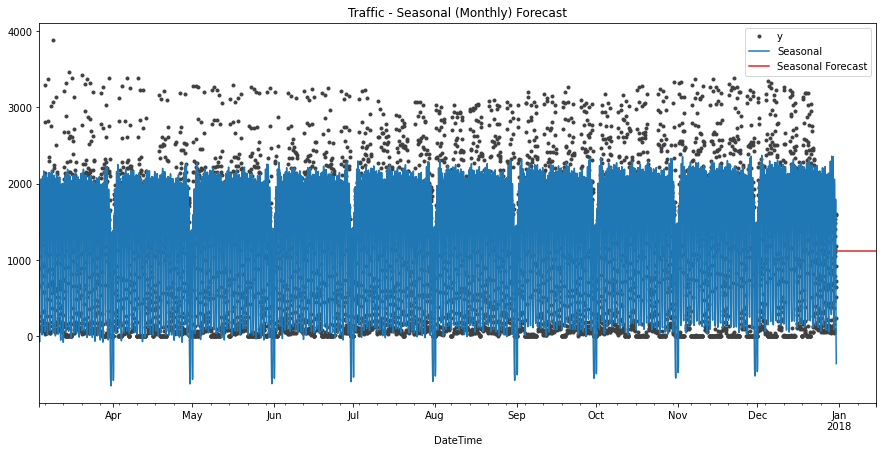

In [65]:
# Fix
X.index = pd.to_datetime(X.index)
y = lr_szn["y"]

lr_mod = LinearRegression(fit_intercept=False)
_ = lr_mod.fit(X, y)

y_pred = pd.Series(lr_mod.predict(X), index=y.index)

# Create future timestamps for forecasting
future_index = pd.date_range(start=y.index[-1], periods=365, freq='H')

# Create future feature matrix
X_fore = pd.DataFrame(data=None, index=future_index, columns=X.columns)

# Fill missing values in X_fore with mean of corresponding feature
X_fore.fillna(X.mean(), inplace=True)

# Make predictions for future timestamps
y_fore = pd.Series(lr_mod.predict(X_fore), index=X_fore.index)

plt.figure(figsize=(15, 7))
ax = y.plot(color='0.25', style='.', title="Traffic - Seasonal (Monthly) Forecast")
ax = y_pred.plot(ax=ax, label="Seasonal")
ax = y_fore.plot(ax=ax, label="Seasonal Forecast", color='C3')
_ = ax.legend()


In [66]:
# #Forecast
# X.index = pd.to_datetime(X.index)
# y = lr_szn["y"]

# lr_mod = LinearRegression(fit_intercept=False)
# _ = lr_mod.fit(X, y)

# y_pred = pd.Series(lr_mod.predict(X), index=y.index)
# X_fore = dp.out_of_sample(steps=8760) #Predicitng 365 hours
# y_fore = pd.Series(lr_mod.predict(X_fore), index=X_fore.index)

# plt.figure(figsize = (15,7))
# ax = y.plot(color='0.25', style='.', title="Traffic - Seasonal (Monthly) Forecast")
# ax = y_pred.plot(ax=ax, label="Seasonal")
# ax = y_fore.plot(ax=ax, label="Seasonal Forecast", color='C3')
# _ = ax.legend()

In [67]:
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0,1098.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0,957.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0,1018.0


In [68]:
reg_df.columns

Index(['y', 'month', 'Public_Hol', 'avg_temp', 'avg_rainfall', 'ds', 'Time',
       'Lag_1', 'Lag_24', 'Lag_1wk'],
      dtype='object')

In [69]:
reg_df.corr()

,y,month,Public_Hol,avg_temp,avg_rainfall,Time,Lag_1,Lag_24,Lag_1wk
y,1.000000,0.142840,-0.061934,0.166900,0.169266,0.043827,0.865827,0.784332,0.857482
month,0.142840,1.000000,0.007349,0.294714,-0.024238,0.870806,0.142114,0.028469,0.039097
Public_Hol,-0.061934,0.007349,1.000000,0.089489,-0.042420,0.000631,-0.061578,-0.041970,0.017585
avg_temp,0.166900,0.294714,0.089489,1.000000,0.487343,-0.034949,0.166361,-0.001931,0.009929
avg_rainfall,0.169266,-0.024238,-0.042420,0.487343,1.000000,-0.429771,0.168592,-0.014190,-0.023854
Time,0.043827,0.870806,0.000631,-0.034949,-0.429771,1.000000,0.044067,0.046176,0.057249
Lag_1,0.865827,0.142114,-0.061578,0.166361,0.168592,0.044067,1.000000,0.684381,0.746746
Lag_24,0.784332,0.028469,-0.041970,-0.001931,-0.014190,0.046176,0.684381,1.000000,0.763514
Lag_1wk,0.857482,0.039097,0.017585,0.009929,-0.023854,0.057249,0.746746,0.763514,1.000000


## Actual LR Calc

In [70]:
final_df['month'].unique()

array([ 3,  4,  5,  6,  7,  8,  9, 10, 11, 12], dtype=int64)

In [71]:
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0,1098.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0,957.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0,1018.0


<AxesSubplot:>

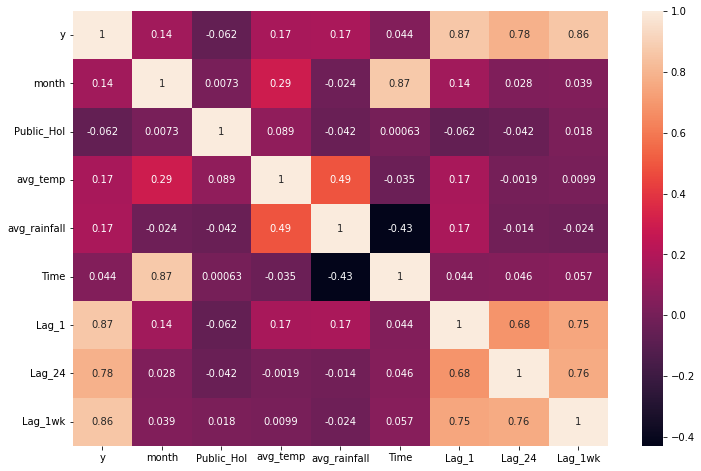

In [72]:
plt.figure(figsize=(12,8))
corr_matrix = reg_df.corr()
sns.heatmap(corr_matrix, annot=True)

This heatmap includes feature engineered variables. Here we see that the lagged traffic counts are the highest correlated which is expected. The average temperature and rainfall also have a moderate positive correlation. 


In [73]:
#X = reg_df.loc[:, ['Temperature(DegC)', 'Wind', 'Humidity', 'Barometer','Public_Hol','Lag_1','Lag_24','Lag_1wk']] #Trying all Lags to see if it improves model.. Trying 1 week as that suits problems tatement more
#X = reg_df.loc[:, ['Rain','Temperature(DegC)','Wind','Humidity','Barometer','Public_Hol','Lag_1wk']] # 1 week is better for business case
X = reg_df.loc[:,['Public_Hol','avg_temp', 'avg_rainfall','Lag_1wk']]
X.dropna(inplace= True) #Drop missing values in the feature set

y = reg_df.loc[:, 'y']
y, X = y.align(X, join ='inner') #Drop the equivalent rows in target

In [74]:
X

,Public_Hol,avg_temp,avg_rainfall,Lag_1wk
DateTime,,,,
2017-03-11 00:00:00,0,19,3.333333,197.0
2017-03-11 01:00:00,0,19,3.333333,111.0
2017-03-11 02:00:00,0,19,3.333333,80.0
2017-03-11 03:00:00,0,19,3.333333,85.0
2017-03-11 04:00:00,0,19,3.333333,130.0
...,...,...,...,...
2017-12-30 19:00:00,0,18,2.142857,1098.0
2017-12-30 20:00:00,0,18,2.142857,957.0
2017-12-30 21:00:00,0,18,2.142857,1018.0


In [75]:
y

DateTime
2017-03-11 00:00:00    175.0
2017-03-11 01:00:00    113.0
2017-03-11 02:00:00     77.0
2017-03-11 03:00:00     69.0
2017-03-11 04:00:00    105.0
                       ...  
2017-12-30 19:00:00    915.0
2017-12-30 20:00:00    724.0
2017-12-30 21:00:00    650.0
2017-12-30 22:00:00    514.0
2017-12-30 23:00:00    234.0
Name: y, Length: 7080, dtype: float64

In [76]:
from sklearn.linear_model import Ridge
from sklearn.model_selection import cross_val_score
from sklearn.linear_model import LinearRegression, Lasso
from sklearn.preprocessing import StandardScaler

In [77]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=.8, shuffle=False, random_state=42)

In [78]:
#scale_cols = ['Temperature(DegC)', 'Humidity', 'Barometer','Wind'] #Cp;umns to scale since they have differnet units to Traffic Count(Lag)
scale_cols = ['avg_temp','avg_rainfall']
scaler = StandardScaler()
scaler.fit(X_train[scale_cols])

X_train_scaled = pd.DataFrame(scaler.transform(X_train[scale_cols]), columns=scale_cols, index=X_train.index)
X_test_scaled = pd.DataFrame(scaler.transform(X_test[scale_cols]), columns=scale_cols, index=X_test.index)

# Convert the columns to the appropriate data types
X_train_remaining = X_train.drop(scale_cols, axis=1).astype(float)
X_test_remaining = X_test.drop(scale_cols, axis=1).astype(float)

# Concatenate the scaled columns with the remaining columns
X_train_scaled = pd.concat([X_train_scaled, X_train_remaining], axis=1)
X_test_scaled = pd.concat([X_test_scaled, X_test_remaining], axis=1)

In [79]:
X_train_scaled

,avg_temp,avg_rainfall,Public_Hol,Lag_1wk
DateTime,,,,
2017-03-11 00:00:00,1.602483,1.020095,0.0,197.0
2017-03-11 01:00:00,1.602483,1.020095,0.0,111.0
2017-03-11 02:00:00,1.602483,1.020095,0.0,80.0
2017-03-11 03:00:00,1.602483,1.020095,0.0,85.0
2017-03-11 04:00:00,1.602483,1.020095,0.0,130.0
...,...,...,...,...
2017-11-01 19:00:00,0.736739,-0.087505,0.0,1172.0
2017-11-01 20:00:00,0.736739,-0.087505,0.0,755.0
2017-11-01 21:00:00,0.736739,-0.087505,0.0,65.0


In [80]:
lr_simple = LinearRegression()
# lr_simple = Ridge(alpha= 1)
lr_simple.fit(X_train_scaled, y_train)

LinearRegression()

In [81]:


train_predictions = lr_simple.predict(X_train_scaled)
test_predictions = lr_simple.predict(X_test_scaled)

lr_train_r2score = r2_score(y_train, train_predictions)
lr_test_r2score = r2_score(y_test, test_predictions)

print("Train R2 Score:", lr_train_r2score)
print("Test R2 Score:", lr_test_r2score)

Train R2 Score: 0.8024193407935146
Test R2 Score: 0.7226110446035654


- Adding more lags improved the model significantly which is expected
Train R2 Score: 0.8866518055728354
Test R2 Score: 0.8739571174248607
- Previously (Just lag_1k):
    - train score: 0.82
    - test score: 0.74
- Scaling the Data:
    - Didnt change the R2 scores
    - Train R2 Score: 0.82018526612867
    - Test R2 Score: 0.7350921509737605
- Removing multiple Weather attributes and only including if it was raining or not:
    - Train R2 Score: 0.7619110511721889
    - Test R2 Score: 0.6671473435285984
- Adding the Weather Attributes back (temp, wind etc) improved the model (+ Scaling since the units for those will be diff to count)
    - Train R2 Score: 0.820193354400658 Test R2 Score: 0.7350066069070993
- Just using Average Auckland Temperature, Rainfall and 1wklag:
    - Train R2 Score: 0.8024193407935145 Test R2 Score: 0.7226110446035637

In [82]:
lr_mse_train = np.sqrt(mean_squared_error(y_train, train_predictions))
lr_mse_test = np.sqrt(mean_squared_error(y_test, test_predictions))
print("Train LR MSE %.2f  " % lr_mse_train)
print("Test LR MSE %.2f  " % lr_mse_test)

Train LR MSE 408.63  
Test LR MSE 524.54  


In [83]:
lr_mae_train = (mean_absolute_error(y_train, train_predictions))
lr_mae_test = (mean_absolute_error(y_test, test_predictions))
print("Train LR MAE %.2f  " % lr_mae_train)
print("Test LR MAE %.2f  " % lr_mae_test)

Train LR MAE 245.34  
Test LR MAE 287.01  


In [84]:
y_train_df = pd.DataFrame(y_train)
y_train_df['Predictions'] = train_predictions
y_test_df = pd.DataFrame(y_test)
y_test_df['Predictions'] = test_predictions


In [85]:
for col, coef in zip(X_train.columns, lr_simple.coef_):
    print('{:<10s}  {:+.06f}'.format(col, coef))

Public_Hol  +71.656110
avg_temp    +132.882848
avg_rainfall  -461.437055
Lag_1wk     +0.876555


- Public_Hol: This feature has a positive importance value of +71.656110. It indicates that having a public holiday has a significant positive impact on the traffic count. It suggests that on public holidays, there tends to be higher traffic volume compared to regular days. It should decrease the amount of cars??

- avg_temp: This feature has the highest positive importance value of +132.882848. It implies that temperature has a strong positive influence on the traffic count. Higher average temperatures are associated with increased traffic volume.

- avg_rainfall: This feature has a negative importance value of -461.437055. It suggests that rainfall has a strong negative impact on the traffic count. Higher average rainfall leads to a decrease in traffic volume. This is expected since unfavorable weather conditions can result in reduced traffic.

- Lag_1wk: This feature has a positive importance value of +0.876555. It indicates that the traffic count from the previous week (lagged value) has a positive impact on the current traffic count. This implies that there is a correlation or dependency between the traffic count of the current week and the traffic count of the previous week.

In [86]:
y_train_df

,y,Predictions
DateTime,,
2017-03-11 00:00:00,175.0,566.648340
2017-03-11 01:00:00,113.0,491.264597
2017-03-11 02:00:00,77.0,464.091387
2017-03-11 03:00:00,69.0,468.474163
2017-03-11 04:00:00,105.0,507.919145
...,...,...
2017-11-01 19:00:00,1189.0,1212.072715
2017-11-01 20:00:00,893.0,846.549218
2017-11-01 21:00:00,53.0,241.726165


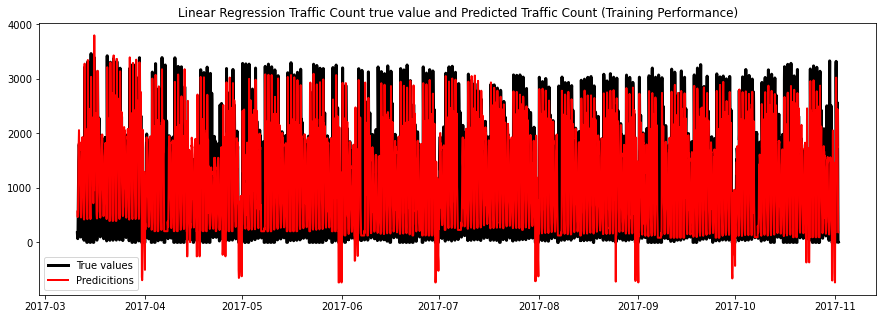

In [87]:
# Visualize our predictions along with the "true" values, and print the score
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(y_train_df['y'], color='k', lw=3)
ax.plot(y_train_df['Predictions'], color='r', lw=2)
ax.legend(['True values', 'Predicitions'])
plt.title('Linear Regression Traffic Count true value and Predicted Traffic Count (Training Performance)')
plt.show()

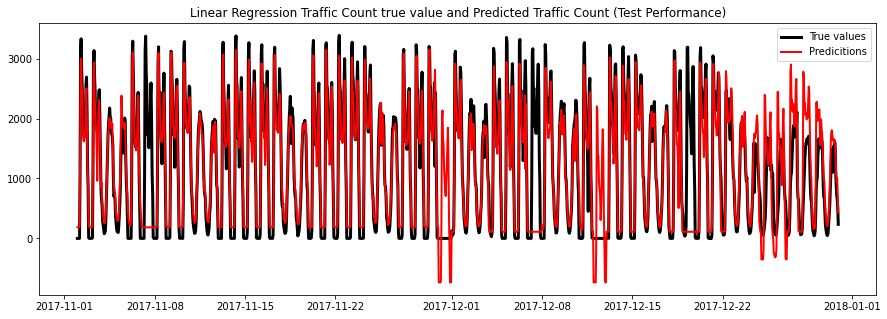

In [88]:
# Visualize our predictions along with the "true" values, and print the score
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(y_test_df['y'], color='k', lw=3)
ax.plot(y_test_df['Predictions'], color='r', lw=2)
ax.legend(['True values', 'Predicitions'])
plt.title('Linear Regression Traffic Count true value and Predicted Traffic Count (Test Performance)')
plt.show()

- Predicts relatively well. Just unable to gauge the depth.
    - After introducing 1hr lag and 24 hr lag as well, it can get the depth more 

- Tried Lasso and Ridge, gave the same R2 scores
    - Suggests that the Dataset doesnt suffer from irrelevant features

#### Forward Feature Selection - Linear Regression

In [89]:
## Flag intermediate output

show_steps = True   # for testing/debugging
# show_steps = False  # without showing steps

In [90]:
#Forward Feature Selection except looking at RMSE

# start with no predictors
included = []
# keep track of model and parameters
best = {'feature': '', 'rmse': np.inf}
# create a model object to hold the modelling parameters
model = LinearRegression() # create a model for Linear Regression
# get the number of cases in the training data
n = X_train.shape[0]

rmse_list = []

while True:
    changed = False
    
    if show_steps:
        print('') 

    # list the features to be evaluated
    excluded = list(set(X.columns) - set(included))
    
    if show_steps:
        print('(Step) Excluded = %s' % ', '.join(excluded))  

    # for each remaining feature to be evaluated
    for new_column in excluded:
        
        if show_steps:
            print('(Step) Trying %s...' % new_column)
            print('(Step) - Features = %s' % ', '.join(included + [new_column]))

        # fit the model with the Training data
        fit = model.fit(X_train_scaled[included + [new_column]], y_train) # fit a model; consider which predictors should be included
        
        # make predictions on the training data
        y_train_pred = fit.predict(X_train_scaled[included + [new_column]])
        
        # calculate the RMSE
        rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
        
        if show_steps:
            print('(Step) - RMSE: This = %.3f; Best = %.3f' % (rmse, best['rmse']))

        # if model improves
        if rmse < best['rmse']:
            # record new parameters
            best = {'feature': new_column, 'rmse': rmse}
            rmse_list.append(rmse)
            # flag that found a better model
            changed = True
            if show_steps:
                print('(Step) - New Best!   : Feature = %s; RMSE = %.3f' % (best['feature'], best['rmse']))
    
    # END for

    # if found a better model after testing all remaining features
    if changed:
        # update control details
        included.append(best['feature'])
        excluded = list(set(excluded) - set(best['feature']))
        print('Added feature %-4s with RMSE = %.3f' % (best['feature'], best['rmse']))
    else:
        # terminate if no better model
        break

print('')
print('Resulting features:')
print(', '.join(included))



(Step) Excluded = Lag_1wk, Public_Hol, avg_rainfall, avg_temp
(Step) Trying Lag_1wk...
(Step) - Features = Lag_1wk
(Step) - RMSE: This = 452.956; Best = inf
(Step) - New Best!   : Feature = Lag_1wk; RMSE = 452.956
(Step) Trying Public_Hol...
(Step) - Features = Public_Hol
(Step) - RMSE: This = 917.613; Best = 452.956
(Step) Trying avg_rainfall...
(Step) - Features = avg_rainfall
(Step) - RMSE: This = 903.058; Best = 452.956
(Step) Trying avg_temp...
(Step) - Features = avg_temp
(Step) - RMSE: This = 907.902; Best = 452.956
Added feature Lag_1wk with RMSE = 452.956

(Step) Excluded = Public_Hol, avg_rainfall, avg_temp
(Step) Trying Public_Hol...
(Step) - Features = Lag_1wk, Public_Hol
(Step) - RMSE: This = 448.565; Best = 452.956
(Step) - New Best!   : Feature = Public_Hol; RMSE = 448.565
(Step) Trying avg_rainfall...
(Step) - Features = Lag_1wk, avg_rainfall
(Step) - RMSE: This = 416.732; Best = 448.565
(Step) - New Best!   : Feature = avg_rainfall; RMSE = 416.732
(Step) Trying avg_te

In [91]:
## Use Forward Feature Selection to pick a good model

# start with no predictors
included = []
# keep track of model and parameters
best = {'feature': '', 'r2': 0, 'a_r2': 0}
# create a model object to hold the modelling parameters
model = LinearRegression() # create a model for Linear Regression
# get the number of cases in the training data
n = X_train.shape[0]

r2_list = []
adjusted_r2_list = []

while True:
    changed = False
    
    if show_steps:
        print('') 

    # list the features to be evaluated
    excluded = list(set(X.columns) - set(included))
    
    if show_steps:
        print('(Step) Excluded = %s' % ', '.join(excluded))  

    # for each remaining feature to be evaluated
    for new_column in excluded:
        
        if show_steps:
            print('(Step) Trying %s...' % new_column)
            print('(Step) - Features = %s' % ', '.join(included + [new_column]))

        # fit the model with the Training data
        
        fit = model.fit(X_train_scaled[included + [new_column]], y_train) # fit a model; consider which predictors should be included
        # calculate the score (R^2 for Regression)
        r2 = fit.score(X_train_scaled[included + [new_column]], y_train) # calculate the score
        
        # number of predictors in this model
        k = len(included) + 1
#         k = len(included + [new_column])
        
        # calculate the adjusted R^2
        adjusted_r2 = 1 - (((1-r2)*(n-1))/(n-k-1)) # calculate the Adjusted R^2

        if show_steps:
            print('(Step) - Adjusted R^2: This = %.3f; Best = %.3f' % 
                  (adjusted_r2, best['a_r2']))

        # if model improves
        if adjusted_r2 > best['a_r2']:
            # record new parameters
            best = {'feature': new_column, 'r2': r2, 'a_r2': adjusted_r2}
            r2_list.append(r2)
            adjusted_r2_list.append(adjusted_r2)
            # flag that found a better model
            changed = True
            if show_steps:
                print('(Step) - New Best!   : Feature = %s; R^2 = %.3f; Adjusted R^2 = %.3f' % 
                      (best['feature'], best['r2'], best['a_r2']))
    # END for

    # if found a better model after testing all remaining features
    if changed:
        # update control details
        included.append(best['feature'])
        excluded = list(set(excluded) - set(best['feature']))
        print('Added feature %-4s with R^2 = %.3f and adjusted R^2 = %.3f' % 
              (best['feature'], best['r2'], best['a_r2']))
    else:
        # terminate if no better model
        break

print('')
print('Resulting features:')
print(', '.join(included))


(Step) Excluded = Lag_1wk, Public_Hol, avg_rainfall, avg_temp
(Step) Trying Lag_1wk...
(Step) - Features = Lag_1wk
(Step) - Adjusted R^2: This = 0.757; Best = 0.000
(Step) - New Best!   : Feature = Lag_1wk; R^2 = 0.757; Adjusted R^2 = 0.757
(Step) Trying Public_Hol...
(Step) - Features = Public_Hol
(Step) - Adjusted R^2: This = 0.003; Best = 0.757
(Step) Trying avg_rainfall...
(Step) - Features = avg_rainfall
(Step) - Adjusted R^2: This = 0.035; Best = 0.757
(Step) Trying avg_temp...
(Step) - Features = avg_temp
(Step) - Adjusted R^2: This = 0.024; Best = 0.757
Added feature Lag_1wk with R^2 = 0.757 and adjusted R^2 = 0.757

(Step) Excluded = Public_Hol, avg_rainfall, avg_temp
(Step) Trying Public_Hol...
(Step) - Features = Lag_1wk, Public_Hol
(Step) - Adjusted R^2: This = 0.762; Best = 0.757
(Step) - New Best!   : Feature = Public_Hol; R^2 = 0.762; Adjusted R^2 = 0.762
(Step) Trying avg_rainfall...
(Step) - Features = Lag_1wk, avg_rainfall
(Step) - Adjusted R^2: This = 0.794; Best = 

- Forward Feature Selection shows that the R2 improves each time a feature is added
- Use all features to get the best model
    - Lag_1wk, Barometer, Public_Hol, Humidity, Temperature(DegC), Wind

#### GridSearchCV - Linear Regression

- Try Linear Regression, with regularisation for gridsearcgh
- However, it was found that regularisation techinques, Lasso and Ridge, dont perform any better than the standard LinearRegression Model. Therefore no Grid Search CV is needed

In [92]:
from sklearn.model_selection import GridSearchCV

In [93]:
param_grid = {'alpha': [0.1, 0.5, 1.0], 'fit_intercept': [True, False]} #Try various alpha parameters

In [94]:
#New Model
lr_gs = Ridge()

In [95]:
grid_search_lr = GridSearchCV(lr_gs, param_grid, cv=5)

In [96]:
#Fit GSCV model to training data
grid_search_lr.fit(X_train_scaled, y_train)

GridSearchCV(cv=5, estimator=Ridge(),
             param_grid={'alpha': [0.1, 0.5, 1.0],
                         'fit_intercept': [True, False]})

In [97]:
# Get the best model and its parameters
best_model = grid_search_lr.best_estimator_
best_params = grid_search_lr.best_params_
print("Best model:", best_model)
print("Best parameters:", best_params)

Best model: Ridge(alpha=0.1, fit_intercept=False)
Best parameters: {'alpha': 0.1, 'fit_intercept': False}


In [98]:
#Evaluate GS model
test_score_lr_gs = best_model.score(X_test_scaled, y_test)
print("Test score LR Grid Search:", test_score_lr_gs)

Test score LR Grid Search: 0.6977527470168465


- Grid Search Didnt improve the Model 

## Prophet

- A time series forecasting model
- It is an additive model based on seasonality (Yearly, Weekly, Daily + Holiday effects). Works best with data that has strong seasonal effects and several seasons of historical data

In [99]:
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0,1098.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0,957.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0,1018.0


In [100]:
#Tell pandas what Frequency we are using. Want to do Hourly/Daily/Weekly
forecast_df = final_df.resample(rule="H").sum() #Hourly
forecast_df

,count,month,Public_Hol,avg_temp,avg_rainfall
DateTime,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333
2017-03-04 01:00:00,111.0,3,0,19,3.333333
2017-03-04 02:00:00,80.0,3,0,19,3.333333
2017-03-04 03:00:00,85.0,3,0,19,3.333333
2017-03-04 04:00:00,130.0,3,0,19,3.333333
...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857
2017-12-30 20:00:00,724.0,12,0,18,2.142857
2017-12-30 21:00:00,650.0,12,0,18,2.142857


In [101]:
#Rename
forecast_df = forecast_df.rename(columns={'count': 'y'})
forecast_df['ds'] = forecast_df.index

In [102]:
forecaster = Prophet(daily_seasonality=True, weekly_seasonality=True, changepoint_prior_scale=0.15, seasonality_prior_scale=10,holidays_prior_scale=15)

In [103]:
#Adding reggresors to improve model
forecaster.add_regressor('Public_Hol')
forecaster.add_regressor('avg_rainfall')
forecaster.add_regressor('avg_temp')

In [104]:
horizon = 30*24 #Predict 30 days into the future. But at the hour intervals 7*24

In [105]:
#Split Data
y_train = forecast_df[:-horizon] #Take all but last X of samples
y_test = forecast_df.tail(horizon)

In [106]:
y_train = y_train.drop(columns='month')

In [107]:
y_train

,y,Public_Hol,avg_temp,avg_rainfall,ds
DateTime,,,,,
2017-03-04 00:00:00,197.0,0,19,3.333333,2017-03-04 00:00:00
2017-03-04 01:00:00,111.0,0,19,3.333333,2017-03-04 01:00:00
2017-03-04 02:00:00,80.0,0,19,3.333333,2017-03-04 02:00:00
2017-03-04 03:00:00,85.0,0,19,3.333333,2017-03-04 03:00:00
2017-03-04 04:00:00,130.0,0,19,3.333333,2017-03-04 04:00:00
...,...,...,...,...,...
2017-11-30 19:00:00,0.0,0,0,0.000000,2017-11-30 19:00:00
2017-11-30 20:00:00,0.0,0,0,0.000000,2017-11-30 20:00:00
2017-11-30 21:00:00,0.0,0,0,0.000000,2017-11-30 21:00:00


In [108]:
y_test = y_test.drop(columns='month')

In [109]:
y_test

,y,Public_Hol,avg_temp,avg_rainfall,ds
DateTime,,,,,
2017-12-01 00:00:00,127.0,0,18,2.142857,2017-12-01 00:00:00
2017-12-01 01:00:00,64.0,0,18,2.142857,2017-12-01 01:00:00
2017-12-01 02:00:00,52.0,0,18,2.142857,2017-12-01 02:00:00
2017-12-01 03:00:00,75.0,0,18,2.142857,2017-12-01 03:00:00
2017-12-01 04:00:00,214.0,0,18,2.142857,2017-12-01 04:00:00
...,...,...,...,...,...
2017-12-30 19:00:00,915.0,0,18,2.142857,2017-12-30 19:00:00
2017-12-30 20:00:00,724.0,0,18,2.142857,2017-12-30 20:00:00
2017-12-30 21:00:00,650.0,0,18,2.142857,2017-12-30 21:00:00


In [110]:
forecaster.fit(y_train)

11:09:50 - cmdstanpy - INFO - Chain [1] start processing
11:09:51 - cmdstanpy - INFO - Chain [1] done processing


In [111]:
fh = ForecastingHorizon(y_test.index, is_relative=False)

In [112]:
#pred_df_train = pd.DataFrame({'ds': fh_train.to_pandas()})
pred_df = y_test
pred_df.reset_index(inplace=True)
pred_df = pred_df.drop(columns=['y', 'DateTime'])
pred_df

,Public_Hol,avg_temp,avg_rainfall,ds
0,0,18,2.142857,2017-12-01 00:00:00
1,0,18,2.142857,2017-12-01 01:00:00
2,0,18,2.142857,2017-12-01 02:00:00
3,0,18,2.142857,2017-12-01 03:00:00
4,0,18,2.142857,2017-12-01 04:00:00
...,...,...,...,...
715,0,18,2.142857,2017-12-30 19:00:00
716,0,18,2.142857,2017-12-30 20:00:00
717,0,18,2.142857,2017-12-30 21:00:00
718,0,18,2.142857,2017-12-30 22:00:00


In [113]:
# pred_df = pd.DataFrame({'ds': fh.to_pandas()})
# pred_df

In [114]:
fh_train = ForecastingHorizon(y_train.index, is_relative=False)

In [115]:
y_train

,y,Public_Hol,avg_temp,avg_rainfall,ds
DateTime,,,,,
2017-03-04 00:00:00,197.0,0,19,3.333333,2017-03-04 00:00:00
2017-03-04 01:00:00,111.0,0,19,3.333333,2017-03-04 01:00:00
2017-03-04 02:00:00,80.0,0,19,3.333333,2017-03-04 02:00:00
2017-03-04 03:00:00,85.0,0,19,3.333333,2017-03-04 03:00:00
2017-03-04 04:00:00,130.0,0,19,3.333333,2017-03-04 04:00:00
...,...,...,...,...,...
2017-11-30 19:00:00,0.0,0,0,0.000000,2017-11-30 19:00:00
2017-11-30 20:00:00,0.0,0,0,0.000000,2017-11-30 20:00:00
2017-11-30 21:00:00,0.0,0,0,0.000000,2017-11-30 21:00:00


In [116]:
#pred_df_train = pd.DataFrame({'ds': fh_train.to_pandas()})
pred_df_train = y_train
pred_df_train.reset_index(inplace=True)
pred_df_train = pred_df_train.drop(columns=['y', 'DateTime'])
pred_df_train

,Public_Hol,avg_temp,avg_rainfall,ds
0,0,19,3.333333,2017-03-04 00:00:00
1,0,19,3.333333,2017-03-04 01:00:00
2,0,19,3.333333,2017-03-04 02:00:00
3,0,19,3.333333,2017-03-04 03:00:00
4,0,19,3.333333,2017-03-04 04:00:00
...,...,...,...,...
6523,0,0,0.000000,2017-11-30 19:00:00
6524,0,0,0.000000,2017-11-30 20:00:00
6525,0,0,0.000000,2017-11-30 21:00:00
6526,0,0,0.000000,2017-11-30 22:00:00


In [117]:
#Predict Train Data
train_predictions = forecaster.predict(pred_df_train)

In [118]:
train_predictions

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,Public_Hol,Public_Hol_lower,Public_Hol_upper,additive_terms,...,extra_regressors_additive,extra_regressors_additive_lower,extra_regressors_additive_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2017-03-04 00:00:00,789.376392,-322.094957,816.602637,789.376392,789.376392,0.0,0.0,0.0,-554.415493,...,346.815989,346.815989,346.815989,-9.697734,-9.697734,-9.697734,0.0,0.0,0.0,234.960899
1,2017-03-04 01:00:00,789.545794,-565.739093,625.076958,789.545794,789.545794,0.0,0.0,0.0,-746.131346,...,346.815989,346.815989,346.815989,-22.918092,-22.918092,-22.918092,0.0,0.0,0.0,43.414447
2,2017-03-04 02:00:00,789.715196,-776.294092,413.323358,789.715196,789.715196,0.0,0.0,0.0,-943.227590,...,346.815989,346.815989,346.815989,-36.554264,-36.554264,-36.554264,0.0,0.0,0.0,-153.512394
3,2017-03-04 03:00:00,789.884597,-689.210281,468.958352,789.884597,789.884597,0.0,0.0,0.0,-894.214746,...,346.815989,346.815989,346.815989,-50.538612,-50.538612,-50.538612,0.0,0.0,0.0,-104.330148
4,2017-03-04 04:00:00,790.053999,-279.867467,891.888659,790.053999,790.053999,0.0,0.0,0.0,-471.915336,...,346.815989,346.815989,346.815989,-64.798552,-64.798552,-64.798552,0.0,0.0,0.0,318.138663
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6523,2017-11-30 19:00:00,1157.172742,-508.745878,675.046357,1157.172742,1157.172742,0.0,0.0,0.0,-1038.422146,...,-1126.310239,-1126.310239,-1126.310239,111.492828,111.492828,111.492828,0.0,0.0,0.0,118.750596
6524,2017-11-30 20:00:00,1157.107674,-979.115443,168.642851,1157.107674,1157.107674,0.0,0.0,0.0,-1580.583735,...,-1126.310239,-1126.310239,-1126.310239,112.922349,112.922349,112.922349,0.0,0.0,0.0,-423.476061
6525,2017-11-30 21:00:00,1157.042605,-1354.801634,-187.477700,1157.042605,1157.042605,0.0,0.0,0.0,-1904.213842,...,-1126.310239,-1126.310239,-1126.310239,114.317446,114.317446,114.317446,0.0,0.0,0.0,-747.171236
6526,2017-11-30 22:00:00,1156.977537,-1383.244172,-194.767558,1156.977537,1156.977537,0.0,0.0,0.0,-1953.942425,...,-1126.310239,-1126.310239,-1126.310239,115.637819,115.637819,115.637819,0.0,0.0,0.0,-796.964888


In [119]:
y_train_pred = train_predictions['yhat'].values

In [120]:
#Predict Test Data
y_pred = forecaster.predict(pred_df)

In [121]:
y_pred

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,Public_Hol,Public_Hol_lower,Public_Hol_upper,additive_terms,...,extra_regressors_additive,extra_regressors_additive_lower,extra_regressors_additive_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2017-12-01 00:00:00,1156.847400,-107.447211,1050.730935,1156.847400,1156.847400,0.0,0.0,0.0,-695.398356,...,78.255507,78.255507,78.255507,117.879885,117.879885,117.879885,0.0,0.0,0.0,461.449044
1,2017-12-01 01:00:00,1156.782331,-290.788332,843.185763,1156.782331,1156.782331,0.0,0.0,0.0,-873.064684,...,78.255507,78.255507,78.255507,118.709053,118.709053,118.709053,0.0,0.0,0.0,283.717647
2,2017-12-01 02:00:00,1156.717263,-501.731976,697.230533,1156.717263,1156.717263,0.0,0.0,0.0,-1055.954355,...,78.255507,78.255507,78.255507,119.279453,119.279453,119.279453,0.0,0.0,0.0,100.762908
3,2017-12-01 03:00:00,1156.652194,-441.171352,739.850012,1156.652194,1156.652194,0.0,0.0,0.0,-992.694727,...,78.255507,78.255507,78.255507,119.541889,119.541889,119.541889,0.0,0.0,0.0,163.957467
4,2017-12-01 04:00:00,1156.587126,57.917261,1180.709466,1156.587126,1156.587126,0.0,0.0,0.0,-556.230247,...,78.255507,78.255507,78.255507,119.447018,119.447018,119.447018,0.0,0.0,0.0,600.356878
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,2017-12-30 19:00:00,1110.323408,372.750345,1473.624044,1099.991629,1119.597042,0.0,0.0,0.0,-200.450719,...,78.255507,78.255507,78.255507,-255.101490,-255.101490,-255.101490,0.0,0.0,0.0,909.872689
716,2017-12-30 20:00:00,1110.258340,-202.613173,900.344988,1099.908259,1119.545622,0.0,0.0,0.0,-751.474275,...,78.255507,78.255507,78.255507,-262.533937,-262.533937,-262.533937,0.0,0.0,0.0,358.784065
717,2017-12-30 21:00:00,1110.193271,-553.888045,567.883111,1099.813854,1119.494203,0.0,0.0,0.0,-1082.899935,...,78.255507,78.255507,78.255507,-268.934393,-268.934393,-268.934393,0.0,0.0,0.0,27.293336
718,2017-12-30 22:00:00,1110.128203,-607.351623,503.842344,1099.719449,1119.442783,0.0,0.0,0.0,-1139.277594,...,78.255507,78.255507,78.255507,-274.263096,-274.263096,-274.263096,0.0,0.0,0.0,-29.149391


In [122]:
y_true = forecast_df.tail(horizon)


In [123]:
y_true = y_test['y']
y_true

0      127.0
1       64.0
2       52.0
3       75.0
4      214.0
       ...  
715    915.0
716    724.0
717    650.0
718    514.0
719    234.0
Name: y, Length: 720, dtype: float64

In [124]:
y_pred['yhat']

0      461.449044
1      283.717647
2      100.762908
3      163.957467
4      600.356878
          ...    
715    909.872689
716    358.784065
717     27.293336
718    -29.149391
719     37.725200
Name: yhat, Length: 720, dtype: float64

In [125]:
y_train_true = y_train['y']

In [126]:
proph_mse_train  = np.sqrt(mean_squared_error(y_train_true, y_train_pred))

proph_mse_test = np.sqrt(mean_squared_error(y_true, y_pred['yhat']))
print('Train Score: %.2f RMSE' % (proph_mse_train))
print('Test Score: %.2f RMSE' % (proph_mse_test))

Train Score: 448.72 RMSE
Test Score: 517.54 RMSE


In [127]:
proph_mape_train = mean_absolute_error(y_train_true, y_train_pred)
proph_mape_test = mean_absolute_error(y_true, y_pred['yhat'])

print('Train Score: %.2f MAE' % (proph_mape_train))
print('Test Score: %.2f MAE' % (proph_mape_test))

Train Score: 318.84 MAE
Test Score: 398.97 MAE


- Model is, on average, predictions off by 424 units

The RMSE can also be compared to the MAE to see whether there are any substantial but uncommon inaccuracies in the forecast. The wider the gap between RMSE and MAE, the more erratic the error size.

In [128]:
#R2 Score
proph_r2_train = r2_score(y_train_true, y_train_pred)
proph_r2_test = r2_score(y_true, y_pred['yhat'])

print('Train Score: %.2f R2' % (proph_r2_train))
print('Test Score: %.2f R2' % (proph_r2_test))

Train Score: 0.77 R2
Test Score: 0.71 R2


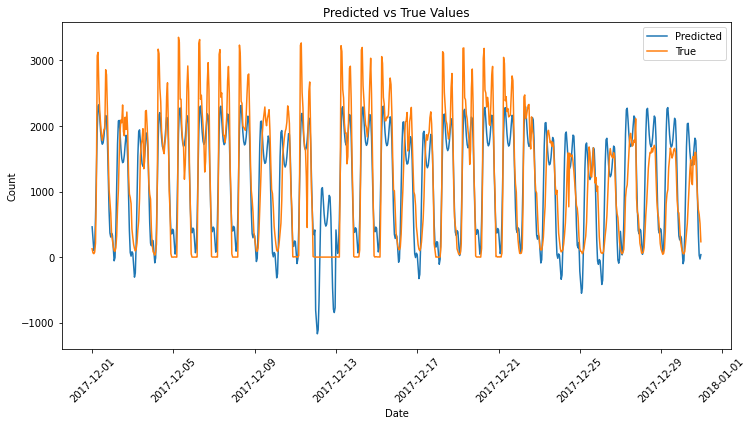

In [129]:
#Validation Set

# Extract the necessary columns from the y_pred dataframe
predicted_values = y_pred['yhat']
true_values = y_true

# Create a line plot to visualize the predicted and true values
plt.figure(figsize=(12, 6))
plt.plot(y_pred['ds'], predicted_values, label='Predicted')
plt.plot(y_pred['ds'], true_values, label='True')
plt.xlabel('Date')
plt.ylabel('Count')
plt.title('Predicted vs True Values')
plt.legend()
plt.xticks(rotation=45)
plt.show()

- Model fits relatively well on its predictions. The R2 score is not bad as well

- Extensive Hyperparameter tuning not required for Prophet model as they have a lot of inbuilt tuning that handles many aspects of feature selection and model fitting automatically

## Decision Trees

In [130]:
from sklearn.tree import DecisionTreeRegressor
from sklearn import tree

In [131]:
dt_simple = DecisionTreeRegressor(max_depth=6) #Leave Everything Default
# dt_simple = DecisionTreeRegressor(max_depth= 6, min_samples_leaf= 1, min_samples_split= 5)

- Same split as Linear Regression

In [132]:
#X = reg_df.loc[:, ['Temperature(DegC)', 'Wind', 'Humidity', 'Barometer','Public_Hol','Lag_1','Lag_24','Lag_1wk']] #Trying all Lags to see if it improves model.. Trying 1 week as that suits problems tatement more
#X = reg_df.loc[:, ['Rain','Temperature(DegC)','Wind','Humidity','Barometer','Public_Hol','Lag_1wk']] # 1 week is better for business case
X = reg_df.loc[:,['Public_Hol','avg_temp', 'avg_rainfall','Lag_1wk']]
X.dropna(inplace= True) #Drop missing values in the feature set

y = reg_df.loc[:, 'y']
y, X = y.align(X, join ='inner') #Drop the equivalent rows in target

In [133]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=.8, shuffle=False, random_state=42)

In [134]:
dt_simple.fit(X_train, y_train)

DecisionTreeRegressor(max_depth=6)

In [135]:
print(dt_simple.tree_.node_count)

81


In [136]:
# make predictions
trainPredict = dt_simple.predict(X_train)
testPredict = dt_simple.predict(X_test)

# calculate root mean squared error
dt_RMSE_train = np.sqrt(mean_squared_error(y_train, trainPredict))
print('Train Score: %.2f RMSE' % (dt_RMSE_train))
dt_RMSE_test = np.sqrt(mean_squared_error(y_test, testPredict))
print('Test Score: %.2f RMSE' % (dt_RMSE_test))

Train Score: 321.66 RMSE
Test Score: 461.95 RMSE


In [137]:
dt_mae_train = mean_absolute_error(y_train, trainPredict)
dt_mae_test = mean_absolute_error(y_test, testPredict)
print('DT MAE Train Score: %.2f' % (dt_mae_train))
print('DT MAE Test Score: %.2f ' % (dt_mae_test))

DT MAE Train Score: 176.63
DT MAE Test Score: 256.75 


In [138]:
#R2 Score
dt_r2_train = r2_score(y_train, trainPredict)
dt_r2_test = r2_score(y_test, testPredict)

print('Train Score: %.2f R2' % (dt_r2_train))
print('Test Score: %.2f R2' % (dt_r2_test))

Train Score: 0.88 R2
Test Score: 0.78 R2


- Adding the extra lag features helped alot. Train Score: 0.95 R2
Test Score: 0.92 R2
- With just 1_week lag and all weather attributes:
    - Train Score: 0.89 R2
    - Test Score: 0.78 R2
- With reduced Weather Attributes:
    - Train Score: 0.80 R2 Test Score: 0.68 R2
- With 1 week lag, all weather attributes and Scaled:
    - Train Score: 0.89 R2 Test Score: 0.78 R2
- With new avg weather uses it results in the same scores
    

In [139]:
for col, importance in zip(X_train.columns, dt_simple.feature_importances_):
    print('{:<10s}  {:+.06f}'.format(col, importance))


Public_Hol  +0.015866
avg_temp    +0.002079
avg_rainfall  +0.091066
Lag_1wk     +0.890989


Public_Hol: This feature has a relatively low importance value of +0.015866. It suggests that the presence of a public holiday has a minor influence on the traffic count in the decision tree model.

avg_temp: This feature has a moderate importance value of +0.056190. It indicates that average temperature has a noticeable impact on the traffic count. Higher average temperatures tend to be associated with increased traffic volume in the decision tree model.

avg_rainfall: This feature has a moderate importance value of +0.036955. It suggests that average rainfall also has a noticeable effect on the traffic count in the decision tree model. Higher average rainfall may lead to a decrease in traffic volume.

Lag_1wk: This feature has the highest importance value of +0.890989. It implies that the traffic count from the previous week (lagged value) has the most significant influence on the current traffic count in the decision tree model. The decision tree model heavily relies on the previous week's traffic count to predict the current traffic count.

In [140]:
y_train_df = pd.DataFrame(y_train)
y_train_df['Predictions'] = trainPredict
y_test_df = pd.DataFrame(y_test)
y_test_df['Predictions'] = testPredict


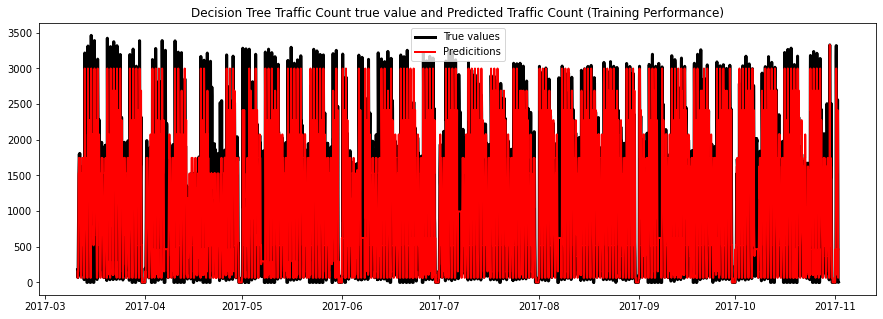

In [141]:
# Visualize our predictions along with the "true" values, and print the score
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(y_train_df['y'], color='k', lw=3)
ax.plot(y_train_df['Predictions'], color='r', lw=2)
ax.legend(['True values', 'Predicitions'])
plt.title('Decision Tree Traffic Count true value and Predicted Traffic Count (Training Performance)')
plt.show()

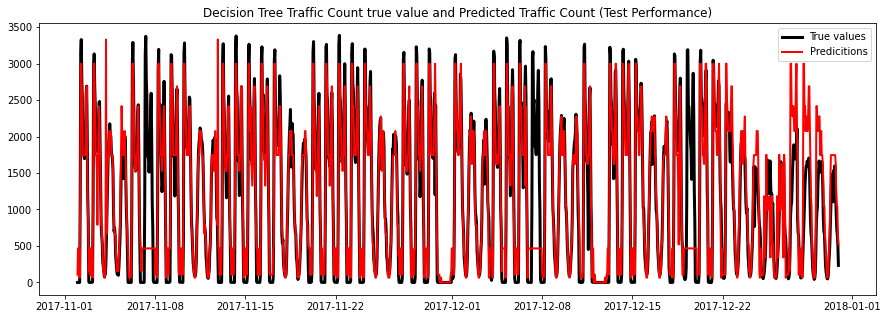

In [142]:
# Visualize our predictions along with the "true" values, and print the score
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(y_test_df['y'], color='k', lw=3)
ax.plot(y_test_df['Predictions'], color='r', lw=2)
ax.legend(['True values', 'Predicitions'])
plt.title('Decision Tree Traffic Count true value and Predicted Traffic Count (Test Performance)')
plt.show()

##### GridSearchCV - Decision Trees

In [143]:
#Set GSCV DT Model
dt_gs = DecisionTreeRegressor()
param_grid = {
    'max_depth':[None, 6, 12, 18],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1,2,4],
}
grid_search_dt = GridSearchCV(dt_gs, param_grid, cv=3)
grid_search_dt.fit(X_train_scaled, y_train)

GridSearchCV(cv=3, estimator=DecisionTreeRegressor(),
             param_grid={'max_depth': [None, 6, 12, 18],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10]})

In [144]:
# Get the best parameters and best score
best_params = grid_search_dt.best_params_
best_score = grid_search_dt.best_score_

print("Best parameters:", best_params)
print("Best score:", best_score)

Best parameters: {'max_depth': 6, 'min_samples_leaf': 1, 'min_samples_split': 5}
Best score: 0.8583549359075366


In [145]:
#Evaluate GS model
best_model = grid_search_dt.best_estimator_
test_score_dt_gs = best_model.score(X_test_scaled, y_test)
print("Test score LR Grid Search:", test_score_dt_gs)

Test score LR Grid Search: 0.7848626697336332


- Grid Search Did not improve the model significantly

## Random Forest

In [146]:
from sklearn.ensemble import RandomForestRegressor

- Same split as Linear Regression & DT

In [147]:
#X = reg_df.loc[:, ['Temperature(DegC)', 'Wind', 'Humidity', 'Barometer','Public_Hol','Lag_1','Lag_24','Lag_1wk']] #Trying all Lags to see if it improves model.. Trying 1 week as that suits problems tatement more
#X = reg_df.loc[:, ['Rain','Temperature(DegC)','Wind','Humidity','Barometer','Public_Hol','Lag_1wk']] # 1 week is better for business case
X = reg_df.loc[:,['Public_Hol','avg_temp', 'avg_rainfall','Lag_1wk']]
X.dropna(inplace= True) #Drop missing values in the feature set

y = reg_df.loc[:, 'y']
y, X = y.align(X, join ='inner') #Drop the equivalent rows in target

In [148]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=.8, shuffle=False, random_state=42)

In [149]:
rf_simple = RandomForestRegressor(n_estimators=100, random_state=42, max_depth = 5)
rf_simple.fit(X_train, y_train)

RandomForestRegressor(max_depth=5, random_state=42)

In [150]:
# make predictions - Scaling on RF and DT for interpretability. They generalyl dont need scaling
trainPredict = rf_simple.predict(X_train)
testPredict = rf_simple.predict(X_test)

# calculate root mean squared error
rf_RMSE_train = np.sqrt(mean_squared_error(y_train, trainPredict))
print('Train Score: %.2f RMSE' % (rf_RMSE_train))
rf_RMSE_test = np.sqrt(mean_squared_error(y_test, testPredict))
print('Test Score: %.2f RMSE' % (rf_RMSE_test))

#R2 Score
rf_r2_train = r2_score(y_train, trainPredict)
rf_r2_test = r2_score(y_test, testPredict)

print('Train Score: %.2f R2' % (rf_r2_train))
print('Test Score: %.2f R2' % (rf_r2_test))

Train Score: 324.05 RMSE
Test Score: 447.64 RMSE
Train Score: 0.88 R2
Test Score: 0.80 R2


In [151]:
rf_mae_train = mean_absolute_error(y_train, trainPredict)
rf_mae_test = mean_absolute_error(y_test, testPredict)
print('RF MAE Train Score: %.2f' % (rf_mae_train))
print('RF MAE Test Score: %.2f ' % (rf_mae_test))

RF MAE Train Score: 178.75
RF MAE Test Score: 252.66 


In [152]:
for col, importance in zip(X_train.columns, rf_simple.feature_importances_):
    print('{:<10s}  {:+.06f}'.format(col, importance))


Public_Hol  +0.014561
avg_temp    +0.046955
avg_rainfall  +0.045352
Lag_1wk     +0.893132


- Public_Hol: This feature has a relatively low importance value of +0.014561. It suggests that the presence of a public holiday has a minor influence on the traffic count in the random forest model.

- avg_temp: This feature has a moderate importance value of +0.046955. It indicates that average temperature has a noticeable impact on the traffic count. Higher average temperatures tend to be associated with increased traffic volume in the random forest model.

- avg_rainfall: This feature also has a moderate importance value of +0.045352. It suggests that average rainfall has a noticeable effect on the traffic count in the random forest model. Higher average rainfall may lead to a decrease in traffic volume.

- Lag_1wk: This feature has the highest importance value of +0.893132. It implies that the traffic count from the previous week (lagged value) has the most significant influence on the current traffic count in the random forest model. The random forest model heavily relies on the previous week's traffic count to predict the current traffic count.

In [153]:
rf_traindf = pd.DataFrame(y_train)
rf_traindf['Predictions'] = trainPredict

rf_testdf = pd.DataFrame(y_test)
rf_testdf['Predictions'] = testPredict

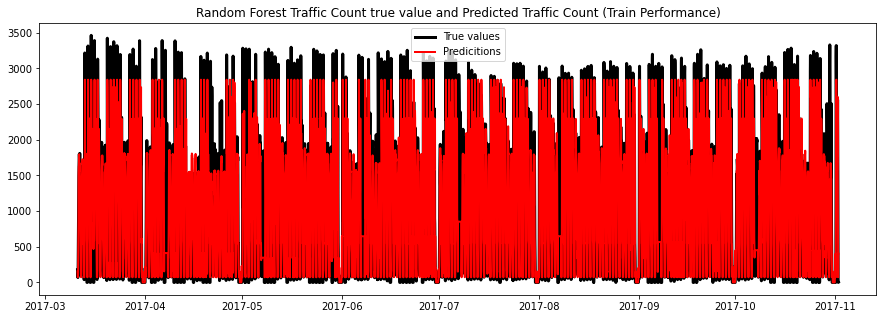

In [154]:
# Visualize our predictions along with the "true" values, and print the score
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(rf_traindf['y'], color='k', lw=3)
ax.plot(rf_traindf['Predictions'], color='r', lw=2)
ax.legend(['True values', 'Predicitions'])
plt.title('Random Forest Traffic Count true value and Predicted Traffic Count (Train Performance)')
plt.show()

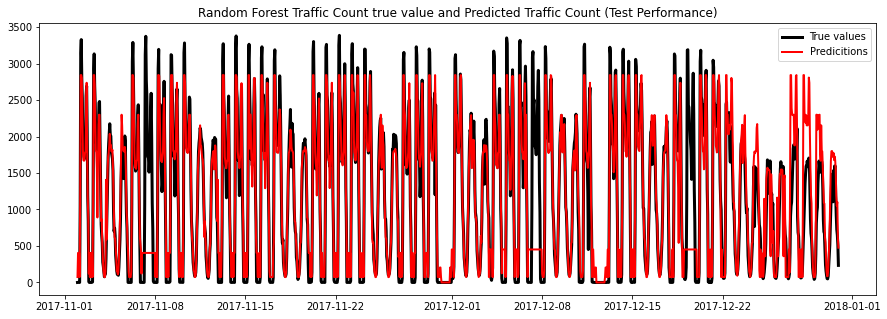

In [155]:
# Visualize our predictions along with the "true" values, and print the score
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(rf_testdf['y'], color='k', lw=3)
ax.plot(rf_testdf['Predictions'], color='r', lw=2)
ax.legend(['True values', 'Predicitions'])
plt.title('Random Forest Traffic Count true value and Predicted Traffic Count (Test Performance)')
plt.show()

- Random forest is the best performing model. Is able to understand the depth better than LR and similar to DT. Tends to underpredict than over predict

#### GridSearchCV - Random Forest

In [156]:
# Stoping Condition #Stopping Condition

In [157]:
rf_gs = RandomForestRegressor()
param_grid = {
    'n_estimators': [100, 200, 300],  # Number of trees in the forest
    'max_depth': [None, 5, 10],       # Maximum depth of the trees
    'min_samples_split': [2, 5, 10],  # Minimum number of samples required to split an internal node
    'min_samples_leaf': [1, 2, 4]     # Minimum number of samples required to be at a leaf node
}

grid_search_rf = GridSearchCV(estimator=rf_gs, param_grid = param_grid, cv=5, scoring='r2')
grid_search_rf.fit(X_train,y_train)


GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'max_depth': [None, 5, 10],
                         'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [100, 200, 300]},
             scoring='r2')

In [158]:
# Print best parameters and score
print("Best parameters: ", grid_search_rf.best_params_)
print("Best score: ", grid_search_rf.best_score_)

Best parameters:  {'max_depth': 5, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 100}
Best score:  0.8631966492642038


In [159]:
# Predict on test set using best estimator
y_pred = grid_search_rf.best_estimator_.predict(X_test)

# Calculate R-squared score on test set
r2 = r2_score(y_test, y_pred)
print("R-squared score on test set: ", r2)

R-squared score on test set:  0.7991952228560593


- Grid Search didnt improve model by much

## Cross Validation

In [160]:
from sklearn.model_selection import cross_val_score

In [161]:



# Perform cross-validation
cv_scores_linear = cross_val_score(lr_simple, X_train, y_train, cv=5, scoring='neg_mean_absolute_error')
cv_scores_tree = cross_val_score(dt_simple, X_train, y_train, cv=5, scoring='neg_mean_absolute_error')
cv_scores_forest = cross_val_score(rf_simple, X_train, y_train, cv=5, scoring='neg_mean_absolute_error')

# Convert the negative MAE scores to positive
cv_scores_linear = -cv_scores_linear
cv_scores_tree = -cv_scores_tree
cv_scores_forest = -cv_scores_forest

# Print the mean MAE scores for each model
print("Linear Regression CV MAE:", cv_scores_linear.mean())
print("Decision Tree CV MAE:", cv_scores_tree.mean())
print("Random Forest CV MAE:", cv_scores_forest.mean())

Linear Regression CV MAE: 269.3699696464295
Decision Tree CV MAE: 186.5078670725732
Random Forest CV MAE: 186.04619659777387


## Linear Regression - Extended

In [162]:
# reg_df = forecast_df
reg_df.head()

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN


In [163]:
reg_df.dtypes

y                      float64
month                    int64
Public_Hol               int64
avg_temp                 int64
avg_rainfall           float64
ds              datetime64[ns]
Time                     int32
Lag_1                  float64
Lag_24                 float64
Lag_1wk                float64
dtype: object

In [164]:
#Time-Step Feature
reg_df['Time'] = np.arange(len(reg_df.index))
reg_df.head()

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN


### Fitting Linear Model

In [165]:
X = reg_df.loc[:, ['Time']]
y = reg_df.loc[:, 'y']

In [166]:
lr_mod = LinearRegression()
lr_mod.fit(X, y)

LinearRegression()

In [167]:
# Store the fitted values as a time series with the same time index as
# the training data
y_pred = pd.Series(lr_mod.predict(X), index=X.index)
y_pred

DateTime
2017-03-04 00:00:00    1052.007554
2017-03-04 01:00:00    1052.027116
2017-03-04 02:00:00    1052.046677
2017-03-04 03:00:00    1052.066238
2017-03-04 04:00:00    1052.085800
                          ...     
2017-12-30 19:00:00    1193.690139
2017-12-30 20:00:00    1193.709700
2017-12-30 21:00:00    1193.729261
2017-12-30 22:00:00    1193.748822
2017-12-30 23:00:00    1193.768384
Length: 7248, dtype: float64

In [168]:
plot_params = dict(
    color="0.75",
    style=".-",
    markeredgecolor="0.25",
    markerfacecolor="0.25",
    legend=False,
)

Text(0.5, 1.0, 'Time Plot of Traffic')

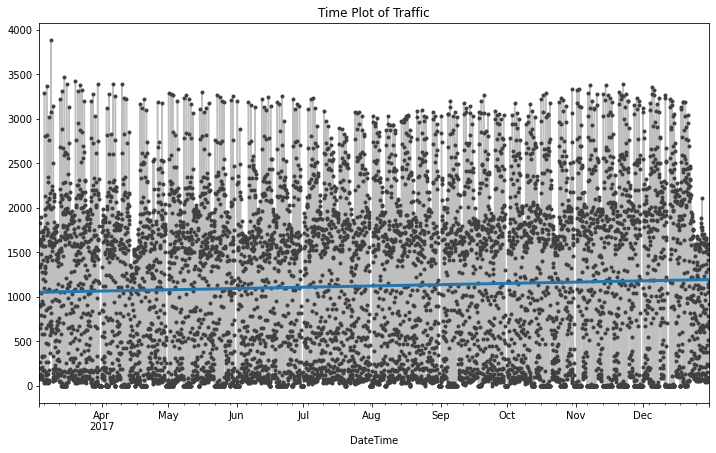

In [169]:
ax = plt.figure(figsize=(12,7))
ax = y.plot(**plot_params)
ax = y_pred.plot(ax=ax, linewidth=3)

ax.set_title('Time Plot of Traffic')



- Plotting the fitted values over time using time dummy variables

### Lag Feature (Lr)

In [170]:
reg_df.columns

Index(['y', 'month', 'Public_Hol', 'avg_temp', 'avg_rainfall', 'ds', 'Time',
       'Lag_1', 'Lag_24', 'Lag_1wk'],
      dtype='object')

In [171]:
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0,1098.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0,957.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0,1018.0


In [172]:
X = reg_df.loc[:, ['Lag_1']]
X.dropna(inplace= True) #Drop missing values in the feature set
y = reg_df.loc[:,'y']
y, X = y.align(X, join ='inner') #Drop the equivalent rows in target


In [173]:
lr_mod = LinearRegression()
lr_mod.fit(X,y)

LinearRegression()

In [174]:
y_pred = pd.Series(lr_mod.predict(X), index = X.index)

Text(0.5, 1.0, '1 hour Lag Plot of Traffic')

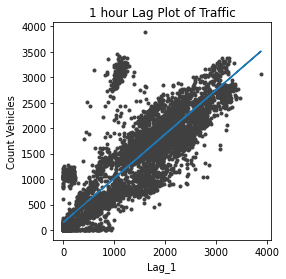

In [175]:
fig, ax = plt.subplots()
ax.plot(X['Lag_1'], y, '.', color='0.25')
ax.plot(X['Lag_1'], y_pred)
ax.set_aspect('equal')
ax.set_ylabel('Count Vehicles')
ax.set_xlabel('Lag_1')
ax.set_title('1 hour Lag Plot of Traffic')



- Lag Plot of Traffic shows how well the model fit the relationship between Vehicle Count in 1 hour vs the number the previous hour

### Lag - 24 hours

In [176]:
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0,1098.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0,957.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0,1018.0


In [177]:
X = reg_df.loc[:, ['Lag_24']]
X.dropna(inplace= True) #Drop missing values in the feature set
y = reg_df.loc[:,'y']
y, X = y.align(X, join ='inner') #Drop the equivalent rows in target


In [178]:
lr_mod = LinearRegression()
lr_mod.fit(X,y)

LinearRegression()

In [179]:
y_pred = pd.Series(lr_mod.predict(X), index = X.index)

Text(0.5, 1.0, '24 hour Lag Plot of Traffic')

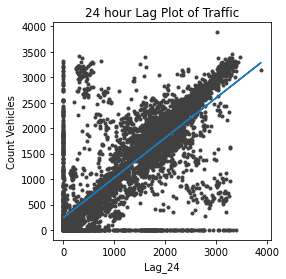

<Figure size 864x504 with 0 Axes>

In [180]:
fig, ax = plt.subplots()
plt.figure(figsize = (12,7))
ax.plot(X['Lag_24'], y, '.', color='0.25')
ax.plot(X['Lag_24'], y_pred)
ax.set_aspect('equal')
ax.set_ylabel('Count Vehicles')
ax.set_xlabel('Lag_24')
ax.set_title('24 hour Lag Plot of Traffic')



### Lag - 1 Week

In [181]:
X = reg_df.loc[:, ['Lag_1wk']]
X.dropna(inplace= True) #Drop missing values in the feature set
y = reg_df.loc[:,'y']
y, X = y.align(X, join ='inner') #Drop the equivalent rows in target


In [182]:
lr_mod = LinearRegression()
lr_mod.fit(X,y)

LinearRegression()

In [183]:
y_pred = pd.Series(lr_mod.predict(X), index = X.index)

Text(0.5, 1.0, '1 Week Lag Plot of Traffic')

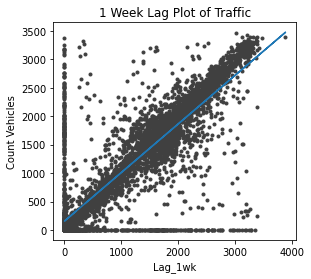

<Figure size 864x504 with 0 Axes>

In [184]:
fig, ax = plt.subplots()
plt.figure(figsize = (12,7))
ax.plot(X['Lag_1wk'], y, '.', color='0.25')
ax.plot(X['Lag_1wk'], y_pred)
ax.set_aspect('equal')
ax.set_ylabel('Count Vehicles')
ax.set_xlabel('Lag_1wk')
ax.set_title('1 Week Lag Plot of Traffic')



### Trend Model

In [185]:
reg_df

,y,month,Public_Hol,avg_temp,avg_rainfall,ds,Time,Lag_1,Lag_24,Lag_1wk
DateTime,,,,,,,,,,
2017-03-04 00:00:00,197.0,3,0,19,3.333333,2017-03-04 00:00:00,0,NaN,NaN,NaN
2017-03-04 01:00:00,111.0,3,0,19,3.333333,2017-03-04 01:00:00,1,197.0,NaN,NaN
2017-03-04 02:00:00,80.0,3,0,19,3.333333,2017-03-04 02:00:00,2,111.0,NaN,NaN
2017-03-04 03:00:00,85.0,3,0,19,3.333333,2017-03-04 03:00:00,3,80.0,NaN,NaN
2017-03-04 04:00:00,130.0,3,0,19,3.333333,2017-03-04 04:00:00,4,85.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,12,0,18,2.142857,2017-12-30 19:00:00,7243,1179.0,860.0,1098.0
2017-12-30 20:00:00,724.0,12,0,18,2.142857,2017-12-30 20:00:00,7244,915.0,695.0,957.0
2017-12-30 21:00:00,650.0,12,0,18,2.142857,2017-12-30 21:00:00,7245,724.0,672.0,1018.0


<AxesSubplot:title={'center':'Traffic - 30-Day Moving Average'}, xlabel='DateTime'>

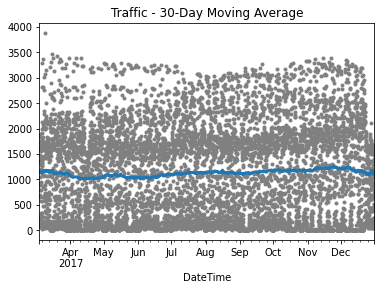

In [186]:
moving_average = reg_df['y'].rolling(
    window = 30*24,   # 30-day window
    center=True,      # puts the average at the center of the window
    min_periods= int((30*24) / 2)  # choose about half the window size
).mean()              # compute the mean (could also do median, std, min, max, ...)

ax = reg_df['y'].plot(style=".", color="0.5")
moving_average.plot(
    ax=ax, linewidth=3, title="Traffic - 30-Day Moving Average", legend=False,
)



- Trend is hard to conclude. 
    - Somehwat linear

### DeterministicProcess:
- a system in which no randomness is involved in the development of future states of the system. A deterministic model will thus always produce the same output from a given starting condition or initial state.

In [187]:
from statsmodels.tsa.deterministic import DeterministicProcess

In [188]:
dp = DeterministicProcess(
    index= reg_df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order=1,             # the time dummy (trend). 1: Linear, 2: Quadratic, 3: Cubic etc
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend
DateTime,,
2017-03-04 00:00:00,1.0,1.0
2017-03-04 01:00:00,1.0,2.0
2017-03-04 02:00:00,1.0,3.0
2017-03-04 03:00:00,1.0,4.0
2017-03-04 04:00:00,1.0,5.0


In [189]:
y = reg_df["y"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.

lr_mod = LinearRegression(fit_intercept=False)
lr_mod.fit(X, y)

y_pred = pd.Series(lr_mod.predict(X), index=X.index)

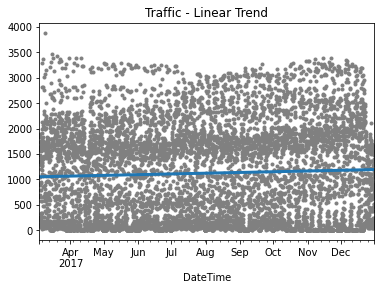

In [190]:
ax = reg_df['y'].plot(style=".", color="0.5", title="Traffic - Linear Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

In [191]:
dp = DeterministicProcess(
    index= reg_df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order= 2,             # the time dummy (trend). 1: Linear, 2: Quadratic, 3: Cubic etc
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend,trend_squared
DateTime,,,
2017-03-04 00:00:00,1.0,1.0,1.0
2017-03-04 01:00:00,1.0,2.0,4.0
2017-03-04 02:00:00,1.0,3.0,9.0
2017-03-04 03:00:00,1.0,4.0,16.0
2017-03-04 04:00:00,1.0,5.0,25.0


In [192]:
y = reg_df["y"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.

lr_mod = LinearRegression(fit_intercept=False)
lr_mod.fit(X, y)

y_pred = pd.Series(lr_mod.predict(X), index=X.index)

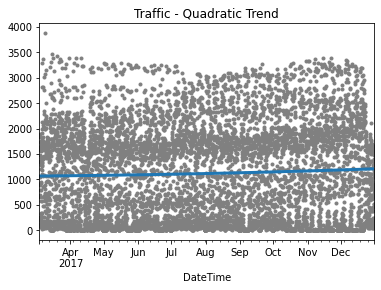

In [193]:
ax = reg_df['y'].plot(style=".", color="0.5", title="Traffic - Quadratic Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

In [194]:
dp = DeterministicProcess(
    index= reg_df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order= 3,             # the time dummy (trend). 1: Linear, 2: Quadratic, 3: Cubic etc
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend,trend_squared,trend_cubed
DateTime,,,,
2017-03-04 00:00:00,1.0,1.0,1.0,1.0
2017-03-04 01:00:00,1.0,2.0,4.0,8.0
2017-03-04 02:00:00,1.0,3.0,9.0,27.0
2017-03-04 03:00:00,1.0,4.0,16.0,64.0
2017-03-04 04:00:00,1.0,5.0,25.0,125.0


In [195]:
y = reg_df["y"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.

lr_mod = LinearRegression(fit_intercept=False)
lr_mod.fit(X, y)

y_pred = pd.Series(lr_mod.predict(X), index=X.index)

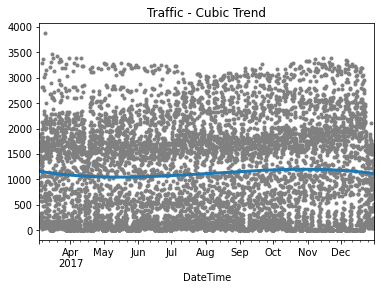

In [196]:
ax = reg_df['y'].plot(style=".", color="0.5", title="Traffic - Cubic Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

In [197]:
dp = DeterministicProcess(
    index= reg_df.index,  # dates from the training data
    constant=True,       # dummy feature for the bias (y_intercept)
    order= 4,             # the time dummy (trend). 1: Linear, 2: Quadratic, 3: Cubic etc
    drop=True,           # drop terms if necessary to avoid collinearity
)
# `in_sample` creates features for the dates given in the `index` argument
X = dp.in_sample()

X.head()

,const,trend,trend_squared,trend_cubed
DateTime,,,,
2017-03-04 00:00:00,1.0,1.0,1.0,1.0
2017-03-04 01:00:00,1.0,2.0,4.0,8.0
2017-03-04 02:00:00,1.0,3.0,9.0,27.0
2017-03-04 03:00:00,1.0,4.0,16.0,64.0
2017-03-04 04:00:00,1.0,5.0,25.0,125.0


In [198]:
y = reg_df["y"]  # the target

# The intercept is the same as the `const` feature from
# DeterministicProcess. LinearRegression behaves badly with duplicated
# features, so we need to be sure to exclude it here.

lr_mod = LinearRegression(fit_intercept=False)
lr_mod.fit(X, y)

y_pred = pd.Series(lr_mod.predict(X), index=X.index)

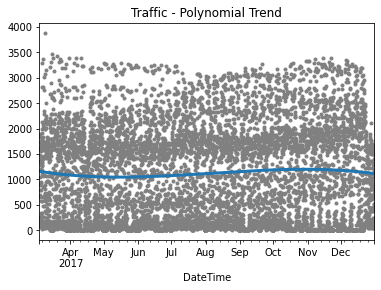

In [199]:
ax = reg_df['y'].plot(style=".", color="0.5", title="Traffic - Polynomial Trend")
_ = y_pred.plot(ax=ax, linewidth=3, label="Trend")

## 2018 Prediction

In [200]:
df_2018 = pd.read_csv('2018_cleandf.csv')
df_2018.head()

,DateTime,count,Week_Day,month,Rain,Temperature(DegC),Wind,Humidity,Barometer,Public_Hol
0,2018-01-01 00:00:00,135.0,Monday,1,False,19.0,7.0,83.0,1011.0,True
1,2018-01-01 01:00:00,168.5,Monday,1,False,19.0,11.0,78.0,1011.0,True
2,2018-01-01 02:00:00,158.0,Monday,1,False,19.0,7.0,78.0,1010.0,True
3,2018-01-01 03:00:00,46.5,Monday,1,False,19.0,4.0,78.0,1010.0,True
4,2018-01-01 04:00:00,1.0,Monday,1,False,18.0,9.0,78.0,1010.0,True


In [201]:

#Using Average Temperature and Rainfall of each month
rainfall_data = {
    1: {'Rainfall': 30, 'Days': 12},
    2: {'Rainfall': 30, 'Days': 10},
    3: {'Rainfall': 40, 'Days': 12},
    4: {'Rainfall': 40, 'Days': 15},
    5: {'Rainfall': 50, 'Days': 17},
    6: {'Rainfall': 50, 'Days': 18},
    7: {'Rainfall': 60, 'Days': 18},
    8: {'Rainfall': 50, 'Days': 18},
    9: {'Rainfall': 40, 'Days': 16},
    10: {'Rainfall': 40, 'Days': 17},
    11: {'Rainfall': 40, 'Days': 15},
    12: {'Rainfall': 30, 'Days': 14}
}
df_rainfall = pd.DataFrame(rainfall_data).T

df_rainfall['Avg_Rainfall_Per_Day'] = df_rainfall['Rainfall'] / df_rainfall['Days'] #Average rainfall per day for a given month

In [202]:
#Temperature Data
temp_data = {
    1: 20,
    2: 20,
    3: 19,
    4: 17,
    5: 14,
    6: 12,
    7: 11,
    8: 12,
    9: 13,
    10: 15,
    11: 16,
    12: 18
}
df_temp = pd.DataFrame.from_dict(temp_data, orient='index', columns=['Avg_Temperature'])
df_temp


,Avg_Temperature
1,20
2,20
3,19
4,17
5,14
6,12
7,11
8,12
9,13
10,15


In [203]:
#Appending the yearly averages of Temp and Rainfall for Auckland
df_2018['avg_rainfall'] = df_2018['month'].map(df_rainfall['Avg_Rainfall_Per_Day'])
df_2018['avg_temp'] = df_2018['month'].map(temp_data)

In [204]:
#Trying to only use the average Temp and Rainfall for a given month
df_2018 = df_2018.drop(columns=['Rain', 'Temperature(DegC)', 'Wind',
       'Humidity', 'Barometer'])
df_2018

,DateTime,count,Week_Day,month,Public_Hol,avg_rainfall,avg_temp
0,2018-01-01 00:00:00,135.0,Monday,1,True,2.500000,20
1,2018-01-01 01:00:00,168.5,Monday,1,True,2.500000,20
2,2018-01-01 02:00:00,158.0,Monday,1,True,2.500000,20
3,2018-01-01 03:00:00,46.5,Monday,1,True,2.500000,20
4,2018-01-01 04:00:00,1.0,Monday,1,True,2.500000,20
...,...,...,...,...,...,...,...
7775,2018-12-30 19:00:00,510.5,Sunday,12,False,2.142857,18
7776,2018-12-30 20:00:00,391.0,Sunday,12,False,2.142857,18
7777,2018-12-30 21:00:00,18.5,Sunday,12,False,2.142857,18
7778,2018-12-30 22:00:00,509.0,Sunday,12,False,2.142857,18


In [205]:
df_2018['DateTime'] = pd.to_datetime(df_2018['DateTime'])
df_2018.dtypes

DateTime        datetime64[ns]
count                  float64
Week_Day                object
month                    int64
Public_Hol                bool
avg_rainfall           float64
avg_temp                 int64
dtype: object

##### Get data from April Onwards since March Data is missing

In [206]:
df_2018_final = df_2018[df_2018['DateTime'].dt.month >= 4]

In [207]:
df_2018_final = df_2018_final.rename(columns={'count':'y'})

In [208]:
df_2018_final

,DateTime,y,Week_Day,month,Public_Hol,avg_rainfall,avg_temp
1552,2018-04-05 00:00:00,0.0,Thursday,4,False,2.666667,17
1553,2018-04-05 01:00:00,0.0,Thursday,4,False,2.666667,17
1554,2018-04-05 02:00:00,0.0,Thursday,4,False,2.666667,17
1555,2018-04-05 03:00:00,0.0,Thursday,4,False,2.666667,17
1556,2018-04-05 04:00:00,51.0,Thursday,4,False,2.666667,17
...,...,...,...,...,...,...,...
7775,2018-12-30 19:00:00,510.5,Sunday,12,False,2.142857,18
7776,2018-12-30 20:00:00,391.0,Sunday,12,False,2.142857,18
7777,2018-12-30 21:00:00,18.5,Sunday,12,False,2.142857,18
7778,2018-12-30 22:00:00,509.0,Sunday,12,False,2.142857,18


In [209]:
df_2018_final.describe()

,y,month,avg_rainfall,avg_temp
count,6228.000000,6228.000000,6228.000000,6228.000000
mean,625.098908,8.094252,2.684223,14.165382
std,604.477860,2.540871,0.328862,2.295206
min,0.000000,4.000000,2.142857,11.000000
25%,93.500000,6.000000,2.500000,12.000000
50%,480.000000,8.000000,2.666667,14.000000
75%,995.500000,10.000000,2.777778,16.000000
max,3228.500000,12.000000,3.333333,18.000000


In [210]:
df_2018_final.corr()

,y,month,Public_Hol,avg_rainfall,avg_temp
y,1.000000,0.033563,-0.058591,-0.016982,0.011362
month,0.033563,1.000000,0.038935,-0.630066,0.392565
Public_Hol,-0.058591,0.038935,1.000000,-0.114065,0.112047
avg_rainfall,-0.016982,-0.630066,-0.114065,1.000000,-0.718708
avg_temp,0.011362,0.392565,0.112047,-0.718708,1.000000


In [211]:
#1 hr Lag
# df_2018_final = lag_creator(df_2018_final, 'Lag_1')

In [212]:
#24 hr Lag
# df_2018_final = lag_creator(df_2018_final, 'Lag_24')

In [213]:
#Get the week lag data
df_2018_final = lag_creator(df_2018_final, 'Lag_1wk')

Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data
Lag_1wk
No Lag data


In [214]:
df_2018_final

,index,y,Week_Day,month,Public_Hol,avg_rainfall,avg_temp,Lag_1wk
DateTime,,,,,,,,
2018-04-05 00:00:00,1552,0.0,Thursday,4,False,2.666667,17,NaN
2018-04-05 01:00:00,1553,0.0,Thursday,4,False,2.666667,17,NaN
2018-04-05 02:00:00,1554,0.0,Thursday,4,False,2.666667,17,NaN
2018-04-05 03:00:00,1555,0.0,Thursday,4,False,2.666667,17,NaN
2018-04-05 04:00:00,1556,51.0,Thursday,4,False,2.666667,17,NaN
...,...,...,...,...,...,...,...,...
2018-12-30 19:00:00,7775,510.5,Sunday,12,False,2.142857,18,203.5
2018-12-30 20:00:00,7776,391.0,Sunday,12,False,2.142857,18,394.0
2018-12-30 21:00:00,7777,18.5,Sunday,12,False,2.142857,18,238.0


#### 2018 Split - Prophet

In [215]:
prophet_2018 = df_2018_final

In [216]:
prophet_2018['ds'] = df_2018_final.index
prophet_2018 = prophet_2018.drop(columns=['month','Week_Day','Lag_1wk'])

In [217]:
prophet_2018['Public_Hol'] = prophet_2018['Public_Hol'].astype(int)
prophet_2018

,index,y,Public_Hol,avg_rainfall,avg_temp,ds
DateTime,,,,,,
2018-04-05 00:00:00,1552,0.0,0,2.666667,17,2018-04-05 00:00:00
2018-04-05 01:00:00,1553,0.0,0,2.666667,17,2018-04-05 01:00:00
2018-04-05 02:00:00,1554,0.0,0,2.666667,17,2018-04-05 02:00:00
2018-04-05 03:00:00,1555,0.0,0,2.666667,17,2018-04-05 03:00:00
2018-04-05 04:00:00,1556,51.0,0,2.666667,17,2018-04-05 04:00:00
...,...,...,...,...,...,...
2018-12-30 19:00:00,7775,510.5,0,2.142857,18,2018-12-30 19:00:00
2018-12-30 20:00:00,7776,391.0,0,2.142857,18,2018-12-30 20:00:00
2018-12-30 21:00:00,7777,18.5,0,2.142857,18,2018-12-30 21:00:00


In [218]:
future_dates = prophet_2018.reset_index('DateTime')
# future_dates = future_dates['DateTime']
future_dates = future_dates.drop(columns=['DateTime','index','y'])
future_dates

,Public_Hol,avg_rainfall,avg_temp,ds
0,0,2.666667,17,2018-04-05 00:00:00
1,0,2.666667,17,2018-04-05 01:00:00
2,0,2.666667,17,2018-04-05 02:00:00
3,0,2.666667,17,2018-04-05 03:00:00
4,0,2.666667,17,2018-04-05 04:00:00
...,...,...,...,...
6223,0,2.142857,18,2018-12-30 19:00:00
6224,0,2.142857,18,2018-12-30 20:00:00
6225,0,2.142857,18,2018-12-30 21:00:00
6226,0,2.142857,18,2018-12-30 22:00:00


In [219]:
# Make predictions for 2018
# future_dates = #forecaster.make_future_dataframe(periods=365)
predictions = forecaster.predict(future_dates)

In [220]:
predictions

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,Public_Hol,Public_Hol_lower,Public_Hol_upper,additive_terms,...,extra_regressors_additive,extra_regressors_additive_lower,extra_regressors_additive_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2018-04-05 00:00:00,961.641840,-253.153503,879.187667,961.641840,961.641840,0.0,0.0,0.0,-655.294664,...,132.319286,132.319286,132.319286,103.919799,103.919799,103.919799,0.0,0.0,0.0,306.347177
1,2018-04-05 01:00:00,961.576772,-448.411486,689.550130,961.576772,961.576772,0.0,0.0,0.0,-834.359136,...,132.319286,132.319286,132.319286,103.350822,103.350822,103.350822,0.0,0.0,0.0,127.217635
2,2018-04-05 02:00:00,961.511703,-635.850692,495.454805,961.511703,961.511703,0.0,0.0,0.0,-1018.356957,...,132.319286,132.319286,132.319286,102.813072,102.813072,102.813072,0.0,0.0,0.0,-56.845254
3,2018-04-05 03:00:00,961.446635,-513.226894,569.024408,961.446635,961.446635,0.0,0.0,0.0,-955.844361,...,132.319286,132.319286,132.319286,102.328476,102.328476,102.328476,0.0,0.0,0.0,5.602274
4,2018-04-05 04:00:00,961.381566,-74.140163,1028.410133,961.381566,961.381566,0.0,0.0,0.0,-519.695466,...,132.319286,132.319286,132.319286,101.918021,101.918021,101.918021,0.0,0.0,0.0,441.686100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6223,2018-12-30 19:00:00,540.323175,-239.587119,1108.934736,247.434433,856.559672,0.0,0.0,0.0,-98.056805,...,78.255507,78.255507,78.255507,-152.707576,-152.707576,-152.707576,0.0,0.0,0.0,442.266370
6224,2018-12-30 20:00:00,540.258106,-741.925013,608.433589,247.296715,856.557212,0.0,0.0,0.0,-628.857341,...,78.255507,78.255507,78.255507,-139.917004,-139.917004,-139.917004,0.0,0.0,0.0,-88.599235
6225,2018-12-30 21:00:00,540.193038,-1018.321977,309.818192,247.158997,856.508074,0.0,0.0,0.0,-941.026432,...,78.255507,78.255507,78.255507,-127.060890,-127.060890,-127.060890,0.0,0.0,0.0,-400.833395
6226,2018-12-30 22:00:00,540.127969,-1089.114488,258.078537,247.021278,856.458506,0.0,0.0,0.0,-979.233450,...,78.255507,78.255507,78.255507,-114.218952,-114.218952,-114.218952,0.0,0.0,0.0,-439.105481


In [221]:
future_dates

,Public_Hol,avg_rainfall,avg_temp,ds
0,0,2.666667,17,2018-04-05 00:00:00
1,0,2.666667,17,2018-04-05 01:00:00
2,0,2.666667,17,2018-04-05 02:00:00
3,0,2.666667,17,2018-04-05 03:00:00
4,0,2.666667,17,2018-04-05 04:00:00
...,...,...,...,...
6223,0,2.142857,18,2018-12-30 19:00:00
6224,0,2.142857,18,2018-12-30 20:00:00
6225,0,2.142857,18,2018-12-30 21:00:00
6226,0,2.142857,18,2018-12-30 22:00:00


In [222]:
proph_mse_test = np.sqrt(mean_squared_error(prophet_2018['y'], predictions['yhat']))
print('Test Score: %.2f RMSE' % (proph_mse_test))

Test Score: 589.60 RMSE


In [223]:
proph_mape_test = mean_absolute_error(prophet_2018['y'], predictions['yhat'])
print('Test Score: %.2f MAE' % (proph_mape_test))

Test Score: 471.87 MAE


- Model is, on average, predictions off by 424 units

The RMSE can also be compared to the MAE to see whether there are any substantial but uncommon inaccuracies in the forecast. The wider the gap between RMSE and MAE, the more erratic the error size.

In [224]:
#R2 Score
proph_r2_test = r2_score(prophet_2018['y'], predictions['yhat'])

print('Test Score: %.2f R2' % (proph_r2_test))

Test Score: 0.05 R2


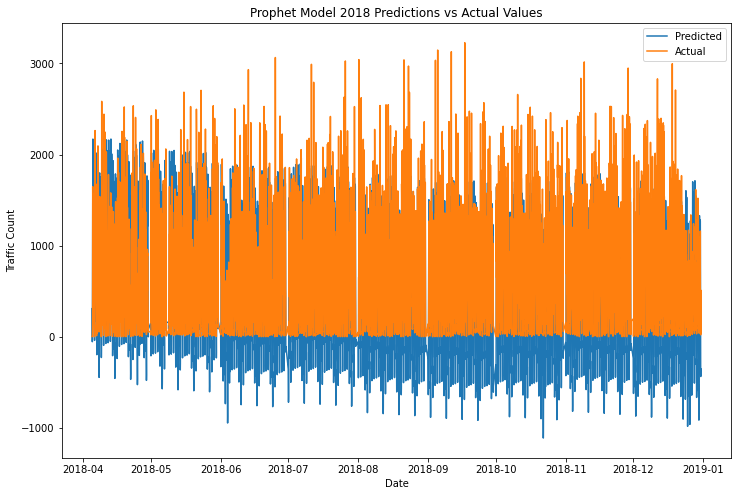

In [225]:
plt.figure(figsize=(12,8))
plt.plot(predictions['ds'], predictions['yhat'], label='Predicted')
plt.plot(prophet_2018['ds'], prophet_2018['y'], label='Actual')
plt.title("Prophet Model 2018 Predictions vs Actual Values")
plt.xlabel("Date")
plt.ylabel("Traffic Count")
plt.legend()
plt.show()

- Prophet model finds it hard to pick up on the irregularness of the 2018 data
- Tends to Underpredict
- Cant judge the dips

#### 2018 Split - Regression

In [226]:
X_2018 = df_2018_final.loc[:,['Public_Hol','avg_temp', 'avg_rainfall','Lag_1wk']]

X_2018.dropna(inplace= True) #Drop missing values in the feature set

y_2018 = df_2018_final.loc[:, 'y']
y_2018, X_2018 = y_2018.align(X_2018, join ='inner') #Drop the equivalent rows in target

In [227]:
X_2018

,Public_Hol,avg_temp,avg_rainfall,Lag_1wk
DateTime,,,,
2018-04-12 00:00:00,False,17,2.666667,0.0
2018-04-12 01:00:00,False,17,2.666667,0.0
2018-04-12 02:00:00,False,17,2.666667,0.0
2018-04-12 06:00:00,False,17,2.666667,1647.0
2018-04-12 07:00:00,False,17,2.666667,1428.0
...,...,...,...,...
2018-12-30 19:00:00,False,18,2.142857,203.5
2018-12-30 20:00:00,False,18,2.142857,394.0
2018-12-30 21:00:00,False,18,2.142857,238.0


In [228]:
y_2018

DateTime
2018-04-12 00:00:00       5.5
2018-04-12 01:00:00      24.5
2018-04-12 02:00:00      15.0
2018-04-12 06:00:00    1779.5
2018-04-12 07:00:00    1570.5
                        ...  
2018-12-30 19:00:00     510.5
2018-12-30 20:00:00     391.0
2018-12-30 21:00:00      18.5
2018-12-30 22:00:00     509.0
2018-12-30 23:00:00     154.5
Name: y, Length: 5818, dtype: float64

In [229]:
# Scale the Data since using Linear Regression and units arent all equivalent
scale_cols = ['avg_temp', 'avg_rainfall'] #Cp;umns to scale since they have differnet units to Traffic Count(Lag)
scaler = StandardScaler()
scaler.fit(X_2018[scale_cols])

X_2018_scaled = pd.DataFrame(scaler.transform(X_2018[scale_cols]), columns=scale_cols, index=X_2018.index)

# Convert the columns to the appropriate data types
X_2018_remaining = X_2018.drop(scale_cols, axis=1).astype(float)

# Concatenate the scaled columns with the remaining columns
X_2018_scaled = pd.concat([X_2018_scaled, X_2018_remaining], axis=1)


In [230]:
X_2018_scaled

,avg_temp,avg_rainfall,Public_Hol,Lag_1wk
DateTime,,,,
2018-04-12 00:00:00,1.275231,-0.050424,0.0,0.0
2018-04-12 01:00:00,1.275231,-0.050424,0.0,0.0
2018-04-12 02:00:00,1.275231,-0.050424,0.0,0.0
2018-04-12 06:00:00,1.275231,-0.050424,0.0,1647.0
2018-04-12 07:00:00,1.275231,-0.050424,0.0,1428.0
...,...,...,...,...
2018-12-30 19:00:00,1.713309,-1.621626,0.0,203.5
2018-12-30 20:00:00,1.713309,-1.621626,0.0,394.0
2018-12-30 21:00:00,1.713309,-1.621626,0.0,238.0


In [231]:
X_train_scaled.columns

Index(['avg_temp', 'avg_rainfall', 'Public_Hol', 'Lag_1wk'], dtype='object')

In [232]:
X_2018_scaled.columns

Index(['avg_temp', 'avg_rainfall', 'Public_Hol', 'Lag_1wk'], dtype='object')

In [233]:
lr_simple #Already been trained previously

LinearRegression()

In [234]:
predictions_2018 = lr_simple.predict(X_2018_scaled)

test_2018_score = r2_score(y_2018, predictions_2018)

print("Test R2 Score:", test_2018_score)

Test R2 Score: 0.29485424130917504


- Adding the multiple lags improved the model alot
    - Just 1 week lag: Test R2 Score: 0.2953511380021716


In [235]:
# calculate root mean squared error
RMSE_2018_lr = np.sqrt(mean_squared_error(y_2018, predictions_2018))
print('2018 Score: %.2f RMSE' % (RMSE_2018_lr))

2018 Score: 506.37 RMSE


In [236]:
MAE_2018_lr = mean_absolute_error(y_2018, predictions_2018)
print('Test Score: %.2f MAE' % (MAE_2018_lr))

Test Score: 356.28 MAE


In [237]:
y_2018_df = pd.DataFrame(y_2018)
y_2018_df['Predictions'] = predictions_2018


In [238]:
y_2018_df

,y,Predictions
DateTime,,
2018-04-12 00:00:00,5.5,228.263736
2018-04-12 01:00:00,24.5,228.263736
2018-04-12 02:00:00,15.0,228.263736
2018-04-12 06:00:00,1779.5,1671.950067
2018-04-12 07:00:00,1570.5,1479.984489
...,...,...
2018-12-30 19:00:00,510.5,229.248023
2018-12-30 20:00:00,391.0,396.231779
2018-12-30 21:00:00,18.5,259.489176


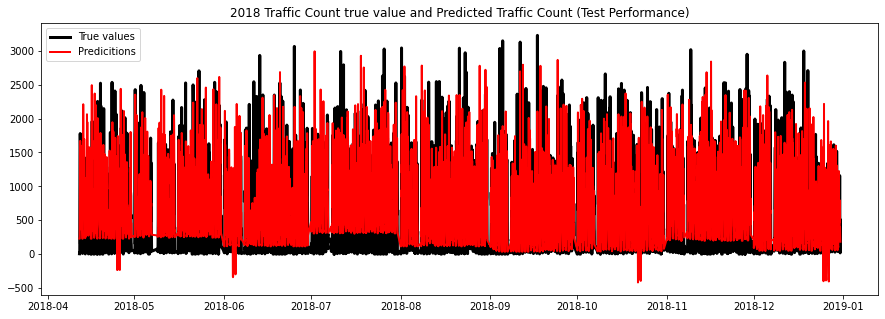

In [239]:
# Visualize our predictions along with the "true" values, and print the score
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(y_2018_df['y'], color='k', lw=3)
ax.plot(y_2018_df['Predictions'], color='r', lw=2)
ax.legend(['True values', 'Predicitions'])
plt.title('2018 Traffic Count true value and Predicted Traffic Count (Test Performance)')
# Set x-axis tick labels
# x_labels = y_2018_df.index.strftime('%Y-%m-%d %H:%M:%S')
# plt.xticks(range(len(x_labels)), x_labels, rotation='vertical')
plt.show()

#### 2018 - Decision Trees

In [240]:
# make predictions
dt_2018_predict = dt_simple.predict(X_2018)

# calculate root mean squared error
testScore = np.sqrt(mean_squared_error(y_2018, dt_2018_predict))
print('2018 DT Test Score: %.2f RMSE' % (testScore))

2018 DT Test Score: 548.80 RMSE


In [241]:
y_dt_2018_df = pd.DataFrame(y_2018)
y_dt_2018_df['Predictions'] = dt_2018_predict

In [242]:
#R2 Score
r2_2018_dt = r2_score(y_2018, dt_2018_predict)

print('2018 Test Score: %.2f R2' % (r2_2018_dt))

2018 Test Score: 0.17 R2


- Just 1 week lag: 2018 Test Score: 0.16 R2


In [243]:
# calculate root mean squared error
RMSE_2018_dt = np.sqrt(mean_squared_error(y_2018, dt_2018_predict))
print('2018 Score: %.2f RMSE' % (RMSE_2018_dt))

2018 Score: 548.80 RMSE


In [244]:
MAE_2018_dt = mean_absolute_error(y_2018, dt_2018_predict)
print('Test Score: %.2f MAE' % (MAE_2018_dt))

Test Score: 371.96 MAE


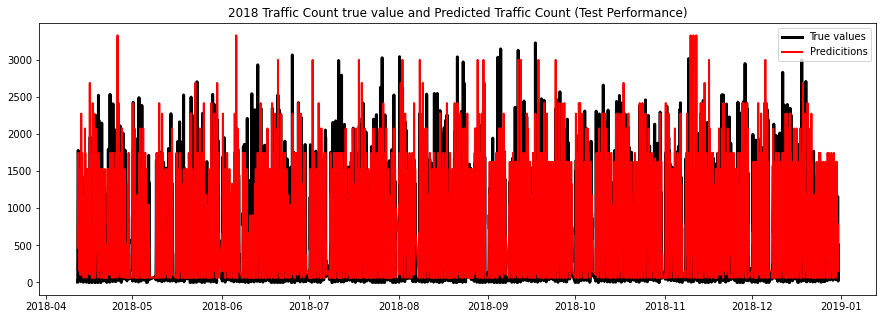

In [245]:
# Visualize our predictions along with the "true" values, and print the score
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(y_dt_2018_df['y'], color='k', lw=3)
ax.plot(y_dt_2018_df['Predictions'], color='r', lw=2)
ax.legend(['True values', 'Predicitions'])
plt.title('2018 Traffic Count true value and Predicted Traffic Count (Test Performance)')
# Set x-axis tick labels
# x_labels = y_2018_df.index.strftime('%Y-%m-%d %H:%M:%S')
# plt.xticks(range(len(x_labels)), x_labels, rotation='vertical')
plt.show()

#### 2018 - Random Forest

In [246]:
# make predictions
rf_2018_predict = rf_simple.predict(X_2018)

In [247]:
# calculate root mean squared error
RMSE_2018_rf = np.sqrt(mean_squared_error(y_2018, rf_2018_predict))
print('2018 Score: %.2f RMSE' % (RMSE_2018_rf))

2018 Score: 535.96 RMSE


In [248]:
#R2 Score
r2_2018_rf = r2_score(y_2018, rf_2018_predict)

print('2018 Test Score: %.2f R2' % (r2_2018_rf))

2018 Test Score: 0.21 R2


- with just 1_week lag: 2018 Test Score: 0.21 R2


In [249]:
MAE_2018_rf = mean_absolute_error(y_2018, rf_2018_predict)
print('Test Score: %.2f MAE' % (MAE_2018_rf))

Test Score: 364.95 MAE


In [250]:
y_rf_2018_df = pd.DataFrame(y_2018)
y_rf_2018_df['Predictions'] = rf_2018_predict
y_rf_2018_df

,y,Predictions
DateTime,,
2018-04-12 00:00:00,5.5,411.942327
2018-04-12 01:00:00,24.5,411.942327
2018-04-12 02:00:00,15.0,411.942327
2018-04-12 06:00:00,1779.5,1668.412025
2018-04-12 07:00:00,1570.5,1551.921307
...,...,...
2018-12-30 19:00:00,510.5,160.987485
2018-12-30 20:00:00,391.0,534.429786
2018-12-30 21:00:00,18.5,212.524511


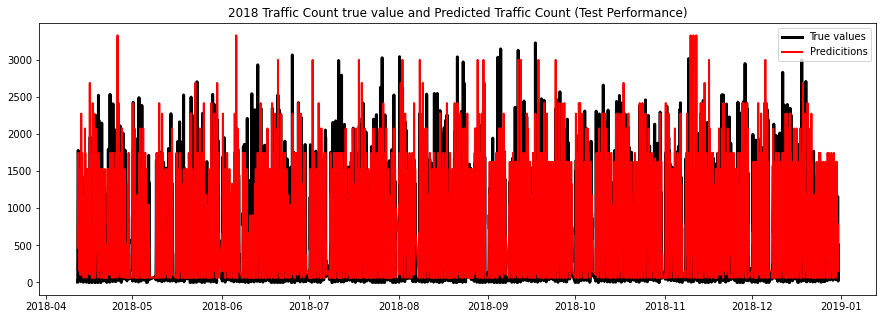

In [251]:
# Visualize our predictions along with the "true" values, and print the score
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(y_dt_2018_df['y'], color='k', lw=3)
ax.plot(y_dt_2018_df['Predictions'], color='r', lw=2)
ax.legend(['True values', 'Predicitions'])
plt.title('2018 Traffic Count true value and Predicted Traffic Count (Test Performance)')
# Set x-axis tick labels
# x_labels = y_2018_df.index.strftime('%Y-%m-%d %H:%M:%S')
# plt.xticks(range(len(x_labels)), x_labels, rotation='vertical')
plt.show()

## 2017 vs 2018

In [252]:
#2017 vs 2018
final_df

,count,Week_Day,month,Public_Hol,avg_temp,avg_rainfall
DateTime,,,,,,
2017-03-04 00:00:00,197.0,Saturday,3,False,19,3.333333
2017-03-04 01:00:00,111.0,Saturday,3,False,19,3.333333
2017-03-04 02:00:00,80.0,Saturday,3,False,19,3.333333
2017-03-04 03:00:00,85.0,Saturday,3,False,19,3.333333
2017-03-04 04:00:00,130.0,Saturday,3,False,19,3.333333
...,...,...,...,...,...,...
2017-12-30 19:00:00,915.0,Saturday,12,False,18,2.142857
2017-12-30 20:00:00,724.0,Saturday,12,False,18,2.142857
2017-12-30 21:00:00,650.0,Saturday,12,False,18,2.142857


In [253]:
df_2018_final

,index,y,Week_Day,month,Public_Hol,avg_rainfall,avg_temp,Lag_1wk,ds
DateTime,,,,,,,,,
2018-04-05 00:00:00,1552,0.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 00:00:00
2018-04-05 01:00:00,1553,0.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 01:00:00
2018-04-05 02:00:00,1554,0.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 02:00:00
2018-04-05 03:00:00,1555,0.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 03:00:00
2018-04-05 04:00:00,1556,51.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 04:00:00
...,...,...,...,...,...,...,...,...,...
2018-12-30 19:00:00,7775,510.5,Sunday,12,False,2.142857,18,203.5,2018-12-30 19:00:00
2018-12-30 20:00:00,7776,391.0,Sunday,12,False,2.142857,18,394.0,2018-12-30 20:00:00
2018-12-30 21:00:00,7777,18.5,Sunday,12,False,2.142857,18,238.0,2018-12-30 21:00:00


In [254]:
final_df.index.month

Int64Index([ 3,  3,  3,  3,  3,  3,  3,  3,  3,  3,
            ...
            12, 12, 12, 12, 12, 12, 12, 12, 12, 12],
           dtype='int64', name='DateTime', length=7007)

In [255]:
test = df_2018_final

In [256]:
test.index = test.index.map(lambda x: x - pd.DateOffset(years=1))
test

,index,y,Week_Day,month,Public_Hol,avg_rainfall,avg_temp,Lag_1wk,ds
DateTime,,,,,,,,,
2017-04-05 00:00:00,1552,0.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 00:00:00
2017-04-05 01:00:00,1553,0.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 01:00:00
2017-04-05 02:00:00,1554,0.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 02:00:00
2017-04-05 03:00:00,1555,0.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 03:00:00
2017-04-05 04:00:00,1556,51.0,Thursday,4,False,2.666667,17,NaN,2018-04-05 04:00:00
...,...,...,...,...,...,...,...,...,...
2017-12-30 19:00:00,7775,510.5,Sunday,12,False,2.142857,18,203.5,2018-12-30 19:00:00
2017-12-30 20:00:00,7776,391.0,Sunday,12,False,2.142857,18,394.0,2018-12-30 20:00:00
2017-12-30 21:00:00,7777,18.5,Sunday,12,False,2.142857,18,238.0,2018-12-30 21:00:00


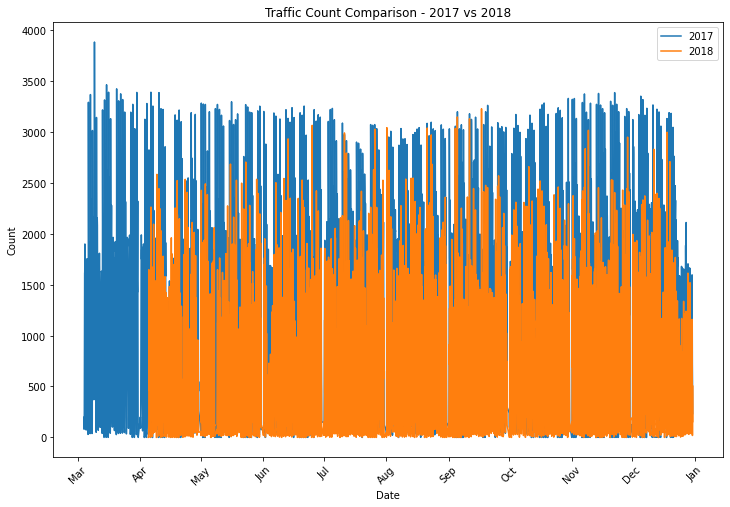

In [257]:
import matplotlib.dates as mdates

plt.figure(figsize=(12, 8))
plt.plot(final_df.index, final_df['count'], label='2017')
plt.plot(test.index, test['y'], label='2018')

# Set the x-axis locator and formatter
plt.gca().xaxis.set_major_locator(mdates.MonthLocator())
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%b'))  # %b displays the abbreviated month name

# Rotate x-axis tick labels if needed
plt.xticks(rotation=45)

# Add a legend
plt.legend()

# Add labels and title
plt.xlabel('Date')
plt.ylabel('Count')
plt.title('Traffic Count Comparison - 2017 vs 2018')

# Show the plot
plt.show()


In [258]:
df_2018_final.shape

(6228, 9)

In [259]:

final_df = final_df[final_df.index.month >= 4]

# Conclusion

Four models were used to predict traffic count. The problem at hand is a regression problem, the models chosen were – Linear Regression, Decision Tree, Random Forest and Prophet. The metrics used to evaluate these models included – Root Mean Squared Error (RMSE), Mean Absolute Error (MAE) and R2. These models were evaluated against each other based on the performance metrics and a final model was decided as the best performing. 

- Random Forest was deemed the best performing Model

Ideally the models would perform better on unseen data. However, with time series forecasting it is key that the datasets are of similar nature to have accurate predictions. Future work could look into how to make future data similar. This can be done by using more historical data

- When testing the models on the 2018 data it didnt perform as well. This is due to the 2018 data not being as regular/similar to the 2017 data. This is the limitation in this project. The real world data proved to be difficult to work with